<!-- group no.8 -->

# Preparations

In [1]:
import os, sys
import random
import warnings

import numpy as np
import pandas as pd
import matplotlib as mpl
import matplotlib.pyplot as plt
import seaborn as sns
import statsmodels.api as sm

#For the plots
%matplotlib inline
mpl.rc('axes', labelsize=14)
mpl.rc('xtick', labelsize=12)
mpl.rc('ytick', labelsize=12)
warnings.filterwarnings('ignore')
plt.style.use('ggplot')

set random reed

In [2]:
random_state = 42
# np.random.seed = random_state
rng = np.random.default_rng(random_state)

In [3]:
train = pd.read_csv('../data/processed/train.csv')
train.drop(['id'], inplace=True, axis=1)

test = pd.read_csv('../data/processed/test.csv')
test.drop(['id'], inplace=True, axis=1)

In [4]:
train['isTrain'] = True
test['isTrain'] = False

test_train = pd.concat([train, test]).reset_index(drop=True).copy()
train.drop(['isTrain'], inplace=True, axis=1)
test.drop(['isTrain'], inplace=True, axis=1)
test_train.tail()

,song_duration_ms,acousticness,danceability,energy,instrumentalness,key,liveness,loudness,audio_mode,speechiness,tempo,time_signature,audio_valence,song_popularity,isTrain
49995,196204.0,0.083936,0.823252,0.442246,0.002990,1.0,0.123921,-8.682195,1,0.041171,98.264618,4,0.784104,NaN,False
49996,218343.0,0.105279,0.683743,0.848627,0.001911,6.0,0.106522,-4.946250,0,0.033605,103.949646,4,0.850754,NaN,False
49997,188434.0,0.753472,0.783947,0.498261,0.134027,6.0,0.088147,-11.812606,1,0.029526,119.090558,4,0.482961,NaN,False
49998,173044.0,0.863579,0.373283,0.476142,0.000049,10.0,0.122122,-12.371232,0,0.190628,103.048349,3,0.518742,NaN,False
49999,157896.0,0.019852,0.720380,NaN,0.037727,2.0,0.139422,-4.965311,1,0.053257,109.873611,4,0.971368,NaN,False


In [5]:
col_y = 'song_popularity'

X = train.copy()
y = X.pop(col_y)

In [6]:
from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=random_state, stratify=y)

In [7]:
# get all column names except song_popularity
FEATURES = [c for c in X.columns.tolist() if c != col_y]
FEATURES

['song_duration_ms',
 'acousticness',
 'danceability',
 'energy',
 'instrumentalness',
 'key',
 'liveness',
 'loudness',
 'audio_mode',
 'speechiness',
 'tempo',
 'time_signature',
 'audio_valence']

In [8]:
train.shape, test.shape, test_train.shape

((40000, 14), (10000, 13), (50000, 15))

# Overview: Structure and Data Content

### Data descrption

Source - Spotify: "In Spotify's API is something called Valence, that describes the musical positiveness conveyed by a track. Tracks with high valence sound more positive (happy, cheerful, euphoric), while tracks with low valence sound more negative (sad, depressed, angry)."

[**From very good article explaining Spotify API What Makes a Song Likeable**?](https://towardsdatascience.com/what-makes-a-song-likeable-dbfdb7abe404)- we can read that:

---

Spotify Audio Features
For every track on their platform, Spotify provides data for thirteen Audio Features.The Spotify Web API developer guide defines them as follows:

* **Danceability:** Describes how suitable a track is for dancing based on a combination of musical elements including tempo, rhythm stability, beat strength, and overall regularity.

* **Valence**: Describes the musical positiveness conveyed by a track. Tracks with high valence sound more positive (e.g. happy, cheerful, euphoric), while tracks with low valence sound more negative (e.g. sad, depressed, angry).

* **Energy**: Represents a perceptual measure of intensity and activity. Typically, energetic tracks feel fast, loud, and noisy. For example, death metal has high energy, while a Bach prelude scores low on the scale.

* **Tempo**: The overall estimated tempo of a track in beats per minute (BPM). In musical terminology, tempo is the speed or pace of a given piece, and derives directly from the average beat duration.

* **Loudness**: The overall loudness of a track in decibels (dB). Loudness values are averaged across the entire track and are useful for comparing relative loudness of tracks.

* **Speechiness**: This detects the presence of spoken words in a track. The more exclusively speech-like the recording (e.g. talk show, audio book, poetry), the closer to 1.0 the attribute value.
Instrumentalness: Predicts whether a track contains no vocals. “Ooh” and “aah” sounds are treated as instrumental in this context. Rap or spoken word tracks are clearly “vocal”.

* **Liveness**: Detects the presence of an audience in the recording. Higher liveness values represent an increased probability that the track was performed live.

* **Acousticness**: A confidence measure from 0.0 to 1.0 of whether the track is acoustic.

* **Key**: The estimated overall key of the track. Integers map to pitches using standard Pitch Class notation . E.g. 0 = C, 1 = C♯/D♭, 2 = D, and so on.

* **Mode**: Indicates the modality (major or minor) of a track, the type of scale from which its melodic content is derived. Major is represented by 1 and minor is 0.

* **Duration**: The duration of the track in milliseconds.

* **Time Signature**: An estimated overall time signature of a track. The time signature (meter) is a notational convention to specify how many beats are in each bar (or measure).

Data Provided by Remek Kinas [SOURCE](https://www.kaggle.com/c/song-popularity-prediction/discussion/301616)

---

Resources for EDA:
* [Song Popularity Prediction EDA with Martin Henze (Heads or Tails)](https://www.youtube.com/watch?v=JXF-7rCcR1c)
* [Song Popularity Prediction: EDA with Martin Henze (Part-2)](https://www.youtube.com/watch?v=2aE6SvCVOis&ab_channel=AbhishekThakur)
* [Song Popularity EDA - Live Coding Fun - Martin Notebook](https://www.kaggle.com/headsortails/song-popularity-eda-live-coding-fun)

## Look at the Data

In [9]:
# check top 5 samples/records
train.head()

,song_duration_ms,acousticness,danceability,energy,instrumentalness,key,liveness,loudness,audio_mode,speechiness,tempo,time_signature,audio_valence,song_popularity
0,212990.0,0.642286,0.856520,0.707073,0.002001,10.0,NaN,-5.619088,0,0.082570,158.386236,4,0.734642,0
1,NaN,0.054866,0.733289,0.835545,0.000996,8.0,0.436428,-5.236965,1,0.127358,102.752988,3,0.711531,1
2,193213.0,NaN,0.188387,0.783524,-0.002694,5.0,0.170499,-4.951759,0,0.052282,178.685791,3,0.425536,0
3,249893.0,0.488660,0.585234,0.552685,0.000608,0.0,0.094805,-7.893694,0,0.035618,128.715630,3,0.453597,0
4,165969.0,0.493017,NaN,0.740982,0.002033,10.0,0.094891,-2.684095,0,0.050746,121.928157,4,0.741311,0


In [10]:
train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 40000 entries, 0 to 39999
Data columns (total 14 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   song_duration_ms  35899 non-null  float64
 1   acousticness      36008 non-null  float64
 2   danceability      35974 non-null  float64
 3   energy            36025 non-null  float64
 4   instrumentalness  36015 non-null  float64
 5   key               35935 non-null  float64
 6   liveness          35914 non-null  float64
 7   loudness          36043 non-null  float64
 8   audio_mode        40000 non-null  int64  
 9   speechiness       40000 non-null  float64
 10  tempo             40000 non-null  float64
 11  time_signature    40000 non-null  int64  
 12  audio_valence     40000 non-null  float64
 13  song_popularity   40000 non-null  int64  
dtypes: float64(11), int64(3)
memory usage: 4.3 MB


In [11]:
# statastical description of dataset
print(train.apply(lambda x: x.nunique()))
train.describe()

song_duration_ms    31586
acousticness        36004
danceability        35972
energy              36021
instrumentalness    35999
key                    12
liveness            35911
loudness            36038
audio_mode              2
speechiness         39999
tempo               39993
time_signature          4
audio_valence       39998
song_popularity         2
dtype: int64


,song_duration_ms,acousticness,danceability,energy,instrumentalness,key,liveness,loudness,audio_mode,speechiness,tempo,time_signature,audio_valence,song_popularity
count,35899.000000,36008.000000,35974.000000,36025.000000,36015.000000,35935.000000,35914.000000,36043.000000,40000.000000,40000.000000,40000.000000,40000.000000,40000.000000,40000.000000
mean,193165.847572,0.276404,0.570951,0.683932,0.036527,5.042605,0.198514,-7.407596,0.321150,0.094107,116.562815,3.394375,0.580645,0.364400
std,45822.127679,0.297928,0.190010,0.212662,0.150024,3.372728,0.151670,3.877198,0.466924,0.083591,26.167911,0.524405,0.237351,0.481268
min,25658.000000,-0.013551,0.043961,-0.001682,-0.004398,0.000000,0.027843,-32.117911,0.000000,0.015065,62.055779,2.000000,0.013398,0.000000
25%,166254.500000,0.039618,0.424760,0.539276,0.000941,2.000000,0.111796,-9.578139,0.000000,0.038500,96.995309,3.000000,0.398669,0.000000
50%,186660.000000,0.140532,0.608234,0.704453,0.001974,5.000000,0.135945,-6.345413,0.000000,0.055881,113.795959,3.000000,0.598827,0.000000
75%,215116.000000,0.482499,0.718464,0.870503,0.003225,8.000000,0.212842,-4.620711,1.000000,0.118842,128.517383,4.000000,0.759635,1.000000
max,491671.000000,1.065284,0.957131,1.039741,1.075415,11.000000,1.065298,-0.877346,1.000000,0.560748,219.163578,5.000000,1.022558,1.000000


We find:

* There are a number of features with values between approximately 0 and 1; such as acousticness, danceability, or liveness among others.
    
* All of loudness values are negative. audio_mode seems even more of a binary feature, and time_signature and key even more of categoricals.

### Missing values

In [12]:
nans_train = train.isnull().sum().sort_values(ascending=False)
nans_test = test.isnull().sum().sort_values(ascending=False)
nans_train = nans_train[nans_train > 0]
nans_test = nans_test[nans_test > 0]
features_with_nans = nans_train.index.values
print(nans_test)

energy              1055
loudness            1026
liveness            1006
instrumentalness    1000
key                  992
danceability         976
song_duration_ms     957
acousticness         950
dtype: int64


In [13]:
mask = X.nunique() < 15
categorical_cols = X.columns[mask]
numerical_cols = [col for col in FEATURES if col not in categorical_cols]

possible reason for these `NaN`s might be disfunctional recording instruments.

In [14]:
percent_nans_train = round((nans_train/train.shape[0]), ndigits=4)
percent_nans_test = round((nans_test/test.shape[0]), ndigits=4)

In [15]:
nans_table_train = pd.concat([
    nans_train, 
    percent_nans_train, 
    pd.Series(False, index=nans_test.index), 
    pd.Series(features_with_nans, index=nans_test.index)], 
    axis=1, keys=['Total', 'Percentage', 'Is_from_test', 'features_with_nans'])
nans_table_test = pd.concat([
    nans_test, 
    percent_nans_test, 
    pd.Series(True, index=nans_test.index),
    pd.Series(features_with_nans, index=nans_test.index)],
    axis=1, keys=['Total', 'Percentage', 'Is_from_test', 'features_with_nans'])
nans_table = pd.concat([nans_table_train, nans_table_test], axis=0)

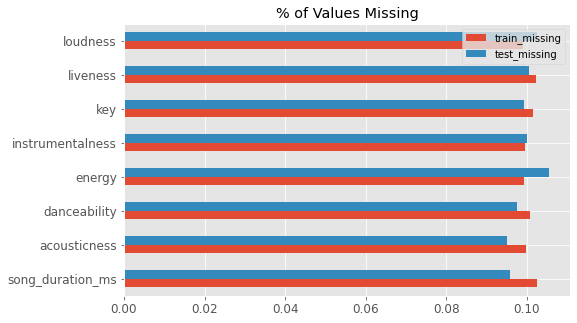

In [16]:
ncounts = pd.DataFrame([train.isna().mean(), test.isna().mean()]).T
ncounts = ncounts.rename(columns={0: "train_missing", 1: "test_missing"})

ncounts.query("train_missing > 0").plot(
    kind="barh", figsize=(8, 5), title="% of Values Missing"
)
plt.show()

In [17]:
# get indice names of ncounts
nacols = ncounts.query("train_missing > 0").index.values.tolist()

### How many missing values per observation?

In [18]:
test_train["n_missing"] = test_train[nacols].isna().sum(axis=1)
train["n_missing"] = train[nacols].isna().sum(axis=1)
test["n_missing"] = test[nacols].isna().sum(axis=1)

<AxesSubplot:title={'center':'Number of Missing Values per Sample'}>

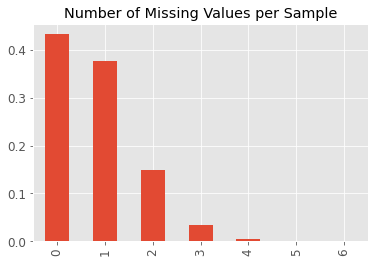

In [19]:
(test_train["n_missing"].value_counts()/test_train.shape[0]).plot(
    kind="bar", title="Number of Missing Values per Sample"
)

Do we see an imbalance in missing values when splitting by other features?

while we'r at it let's also check target imbalance

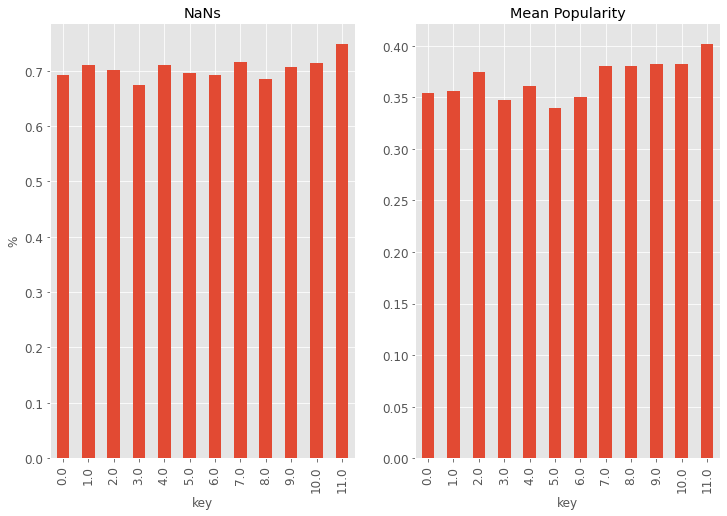

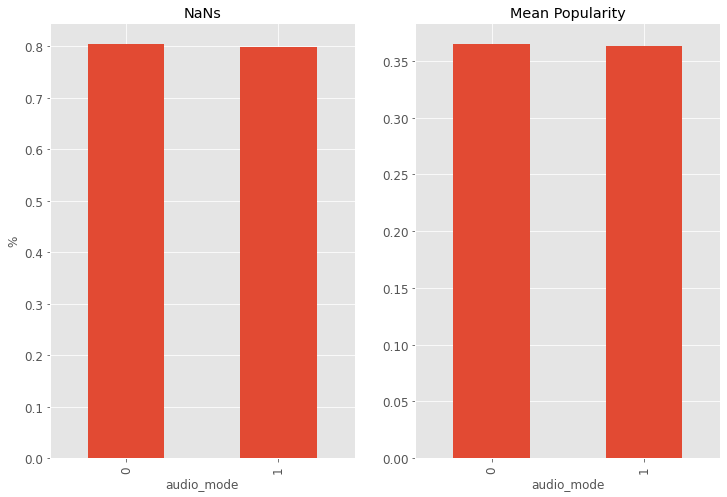

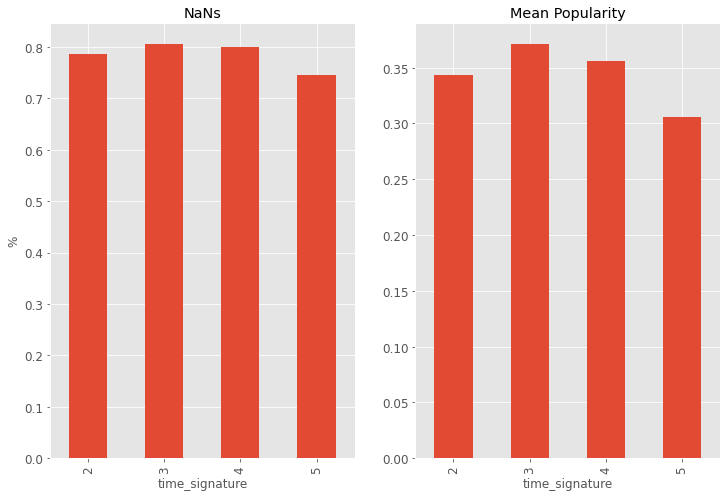

In [20]:
for col in categorical_cols:
    _, axs = plt.subplots(1, 2, figsize=(12, 8))
    test_train.groupby(col)["n_missing"].mean().plot(kind="bar", ax=axs[0], ylabel="%", title='NaNs')
    test_train.groupby(col)[col_y].mean().plot(kind="bar", ax=axs[1], title='Mean Popularity')

We find that:

* Not all features have missing values, though. We find them only in the first 8 columns (not counting the id). Consequently, those columns have around 10% missing values.

* There are some slight differences in the train vs test percentages of missing values for most features.

* overall there's more than 35% of records which has at least 1 missing feature

* there isn't much imbalance in missing values when splitting by features

## Feature transformations

In [21]:
# convert audio_mode, key & time_signature column values to categorical
train[categorical_cols] = train[categorical_cols].astype('category')
# get levels of categorical columns
train[categorical_cols].apply(lambda x: x.cat.categories)

key               Float64Index([0.0, 1.0, 2.0, 3.0, 4.0, 5.0, 6....
audio_mode                        Int64Index([0, 1], dtype='int64')
time_signature              Int64Index([2, 3, 4, 5], dtype='int64')
dtype: object

Try to predict the target using only missing value indicators as features

In [22]:
from sklearn.linear_model import LogisticRegressionCV
from sklearn.metrics import roc_auc_score

lr = LogisticRegressionCV(scoring="accuracy")

tt_missing_tag_df = test_train[nacols].isna()
tt_missing_tag_df.columns = \
    [f"{c}_missing" for c in tt_missing_tag_df.columns]

test_train = pd.concat([test_train, tt_missing_tag_df], axis=1)

X_tmp = test_train.query("isTrain")[
    [
        "song_duration_ms_missing",
        "acousticness_missing",
        "danceability_missing",
        "energy_missing",
        "instrumentalness_missing",
        "key_missing",
        "liveness_missing",
        "loudness_missing",
    ]
]

y_tmp = test_train.query("isTrain")[col_y]

lr.fit(X_tmp, y_tmp)
lr.score(X_tmp, y_tmp)

preds = lr.predict_proba(X_tmp)[:, 0]

roc_auc_score(y_tmp, preds)

0.4928022710677621

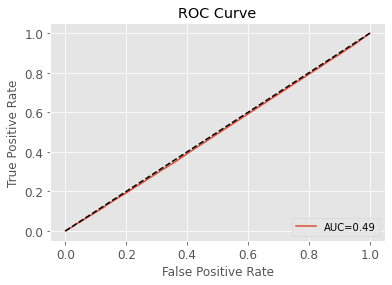

In [23]:
# plot auc-roc curve
from sklearn.metrics import roc_curve

fpr, tpr, thresholds = roc_curve(y_tmp, preds)
auc = roc_auc_score(y_tmp, preds)

plt.plot(fpr, tpr, label="AUC=%0.2f" % auc)
plt.plot([0, 1], [0, 1], "k--")
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")
plt.title("ROC Curve")
plt.legend(loc="lower right")
plt.show()

## Data visualization - Individual Features

Things to take into consideration:
* different scales
* missing values
* log transformations needed for skewed

Candidates for transformations: spechiness, tempo, loudness, acoustiness, liveness, energry, danceability?

Normal ditibuted: song_duration



#### Discrete variables plots

In [24]:
#Checking out unique values in discrete variables
num_categorical = ['audio_mode', 'time_signature', 'key']
for i in num_categorical:
  print(f"{i}, {train[i].unique()} length: {len(train[i].unique())}")

audio_mode, [0, 1]
Categories (2, int64): [0, 1] length: 2
time_signature, [4, 3, 2, 5]
Categories (4, int64): [2, 3, 4, 5] length: 4
key, [10.0, 8.0, 5.0, 0.0, 4.0, ..., 2.0, 7.0, 1.0, 9.0, 11.0]
Length: 13
Categories (12, float64): [0.0, 1.0, 2.0, 3.0, ..., 8.0, 9.0, 10.0, 11.0] length: 13


In [25]:
cont_cols = ['song_duration_ms',	'acousticness',	'danceability',	'energy',	'instrumentalness',	'liveness',	'loudness',	'speechiness',	'tempo', 'audio_valence', 'instrumentalness - log']

In [26]:
train['instrumentalness - log'] = np.log(train['instrumentalness'])

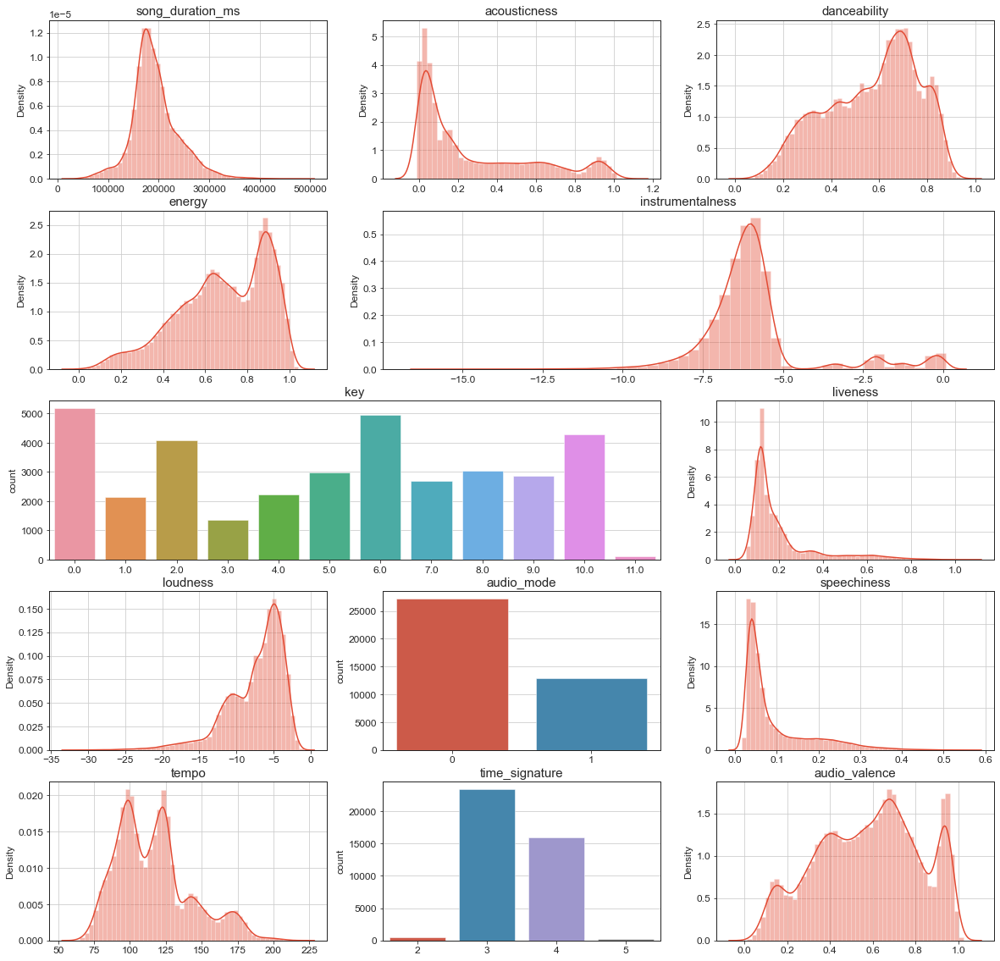

In [27]:
sns.set_style('ticks', {'axes.grid': True})

fig = plt.figure(figsize=(20,20))

axes = [plt.subplot2grid((5, 3), (0, 0)),
        plt.subplot2grid((5, 3), (0, 1)),
        plt.subplot2grid((5, 3), (0, 2)),
        plt.subplot2grid((5, 3), (1, 0)),
        plt.subplot2grid((5, 3), (1, 1), colspan=2),
        plt.subplot2grid((5, 3), (2, 0), colspan=2),
        plt.subplot2grid((5, 3), (2, 2)),
        plt.subplot2grid((5, 3), (3, 0)),
        plt.subplot2grid((5, 3), (3, 1)),
        plt.subplot2grid((5, 3), (3, 2)),
        plt.subplot2grid((5, 3), (4, 0)),
        plt.subplot2grid((5, 3), (4, 1)),
        plt.subplot2grid((5, 3), (4, 2))]

for i, variable in enumerate(FEATURES):
        if variable == 'instrumentalness':
            sns.distplot(np.log(train[variable]), ax=axes[i], kde=True)
        elif variable not in cont_cols:
            sns.countplot(x=variable, data=train, ax=axes[i])
        else:
            sns.distplot(train[variable], ax=axes[i], kde=True)
        axes[i].set_title(variable, fontsize=15)
        axes[i].set_xlabel('')

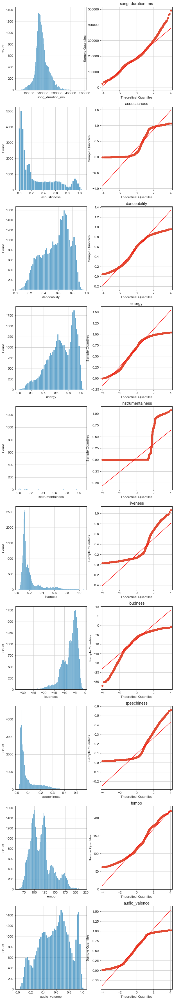

In [28]:
fig, axs = plt.subplots(len(numerical_cols), 2,
                        figsize=(10, len(train.columns)*4))

for i, col in enumerate(numerical_cols):
    sns.histplot(X[col], ax=axs[i, 0])
    sm.qqplot(X[col].dropna(), line="s", ax=axs[i, 1], fmt='b')
    axs[i, 1].set_title(col)

We find:

* Our initial impressions of the data types have largely been confirmed: `audio_mode` is a boolean feature, and time_signature and key are ordinal or categorical ones (or integer; although a better understanding of those musical concepts would certainly benefit from some domain knowledge.)

* A number of features are bounded between 0 and 1: `accosticness`, `danceability`, `energy`, `liveliness`, `speechiness`, and `audio_valence`.

* The feature `loudness` looks like it refer to the decibel scale.

* The distribution of `instrumentalness` is heavily right-skewed, and even after a log transform this feature doesn't look very well-behaved. This might need a bit more work.

* A Box-Cox transformation would be useful, especially for `loudness` and `song_duration_ms`

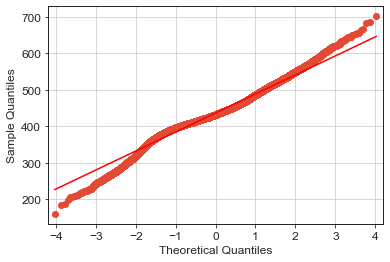

In [29]:
_ = sm.qqplot(
    X['song_duration_ms'].dropna().apply(
        lambda x: np.sqrt(x)),
    line="s", fmt='b'
)

The other columns seem to be outputs of sigmoid functions. If we apply the inverse sigmoid we should get the logits values. Then we can box-cox transform.

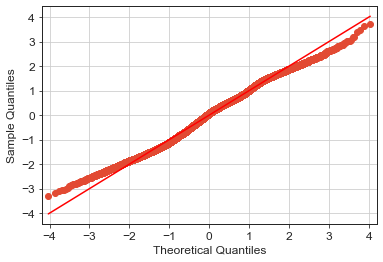

In [30]:
# import power transform

from sklearn.preprocessing import PowerTransformer, power_transform

inv_sigmoid = lambda x: np.log(x / (1-x))

# danceability_processed = PowerTransformer(method='box-cox', standardize=True).fit_transform(X[['danceability']].dropna().apply(inv_sigmoid))

_ = sm.qqplot(
    power_transform(
        X[['danceability']].dropna().apply(inv_sigmoid)
    )[:, 0],
    # danceability_processed,
    line="s", fmt='b'
)

#### Target variable plot

It seems that we'are dealing with imbalanced, maybe some balancing should be in order. 

<AxesSubplot:xlabel='song_popularity', ylabel='count'>

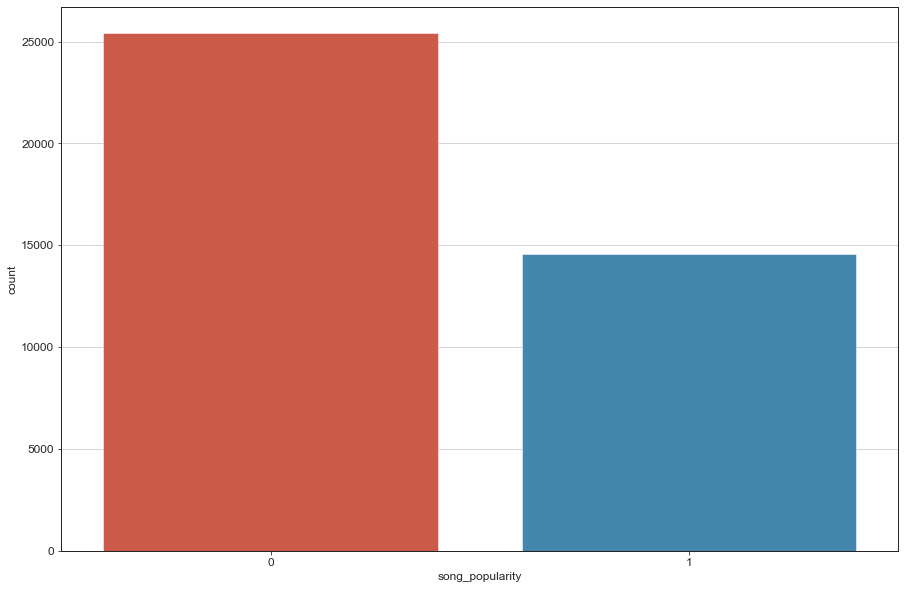

In [31]:
fig, ax = plt.subplots(figsize=(15,10))
sns.countplot(data=train, x=col_y)

There is a slight imbalance in the target distribution: a bit more than 60/40. Not super imbalanced, but something to keep in mind.


## Feature Interactions

After learning more about each individual feature, we now want to see them interacting with one another.

We will start with studying the impact of the target song_popularity on each individual feature, then look at correlations and relationships between the predictor features, before moving on to even higher dimensional relationships.

### Target Impact
We have seen all the feature distributions, now we want to investigate whether they look different based on the target value.

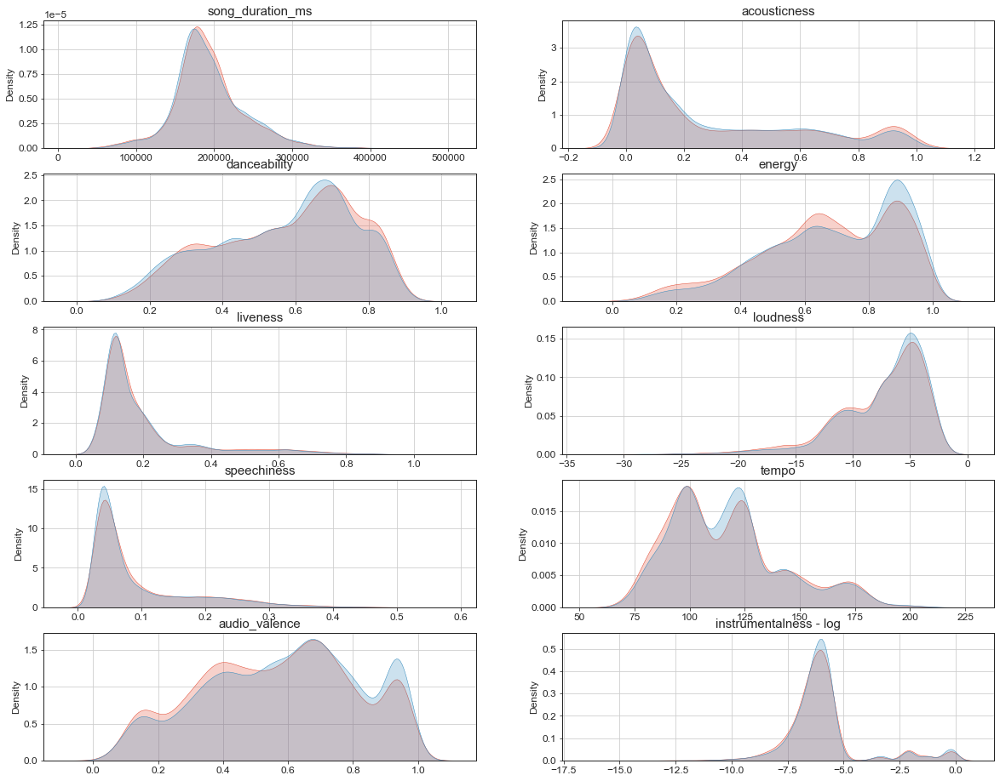

In [32]:
features = FEATURES.copy()
features.append('instrumentalness - log')
features.remove('instrumentalness')

sns.set_style('ticks', {'axes.grid': True})

fig = plt.figure(figsize=(20,16))

axes = [plt.subplot2grid((5, 2), (0, 0)),
        plt.subplot2grid((5, 2), (0, 1)),
        plt.subplot2grid((5, 2), (1, 0)),
        plt.subplot2grid((5, 2), (1, 1)),
        plt.subplot2grid((5, 2), (2, 0)),
        plt.subplot2grid((5, 2), (2, 1)),
        plt.subplot2grid((5, 2), (3, 0)),
        plt.subplot2grid((5, 2), (3, 1)),
        plt.subplot2grid((5, 2), (4, 0)),
        plt.subplot2grid((5, 2), (4, 1))]
i = 0
for variable in features:
        if variable not in num_categorical and variable != col_y:
                sns.kdeplot(train[variable][train[col_y] == True], ax=axes[i], fill = True)
                sns.kdeplot(train[variable][train[col_y] == False], ax=axes[i], fill=True)
                axes[i].set_title(variable, fontsize=15)
                axes[i].set_xlabel('')
                i += 1

There are no features that show strong differences in their distributions for popular vs unpopular songs. No smoking guns here.

Some features like `energy`, `audio_valence`, and perhaps `tempo` show some degree of difference between target classes. Others, like `song_duration_ms` or `liveness` appear to overlap almost perfectly.

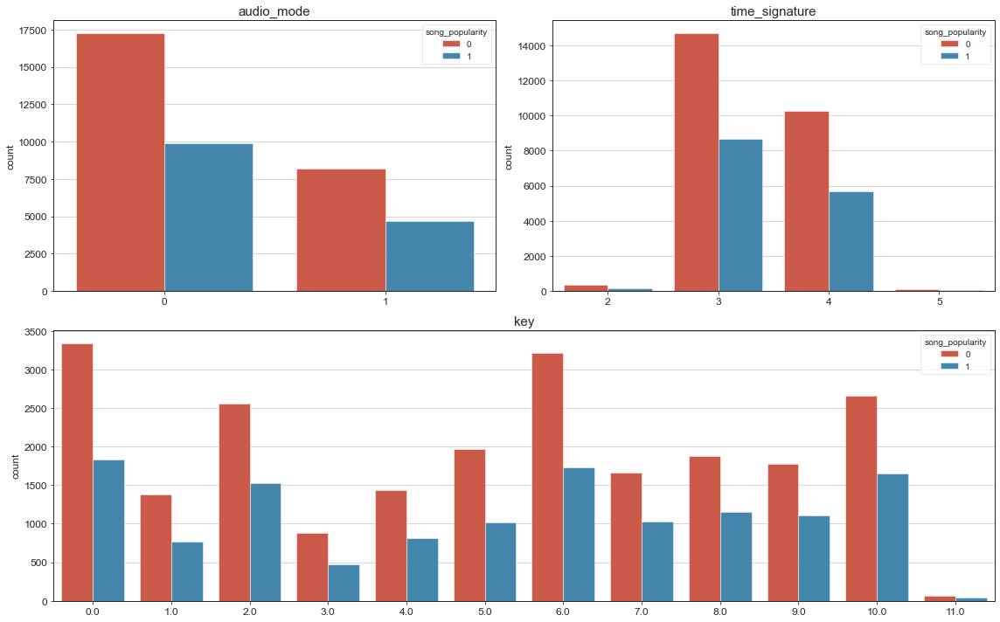

In [33]:
from matplotlib import patches as mpatches

fig = plt.figure(figsize=(16,10))

axes = [plt.subplot2grid((2, 2), (0, 0)),
        plt.subplot2grid((2, 2), (0, 1)),
        plt.subplot2grid((2, 2), (1, 0),  colspan=2)]

for i, variable in enumerate(['audio_mode', 'time_signature', 'key']):
        sns.countplot(x=variable, hue=col_y, data=train, ax=axes[i])
        axes[i].set_title(variable, fontsize=15)
        axes[i].set_xlabel('')

plt.tight_layout()
plt.show()

This kind of view does tell us as much, though, because the imbalance between popular and unpopular songs appears to be pretty universal for all realisations of all features. In order to see the relative percentages of song_popularity = 1 or 0 (or true vs false as we're expressing it here) we need to compute those fractions for every feature & value combination

In this 2nd step, we will only look at the percentage of popular songs (since the percentage of unpopular songs is uniquely determined by 1 - percentage of popular songs in a binary setting.):

### Predictor Feature Interactions

In [34]:
corr_matrix = X.corr()
corr_matrix

,song_duration_ms,acousticness,danceability,energy,instrumentalness,key,liveness,loudness,audio_mode,speechiness,tempo,time_signature,audio_valence
song_duration_ms,1.000000,-0.166443,-0.061929,0.148531,-0.024337,0.019354,0.033009,0.152954,-0.017211,-0.001236,0.085490,0.021609,-0.006948
acousticness,-0.166443,1.000000,-0.093737,-0.570177,0.072516,-0.186663,-0.124704,-0.532724,0.066973,-0.130244,-0.190964,-0.205307,-0.250310
danceability,-0.061929,-0.093737,1.000000,0.099933,-0.146447,0.120514,0.045400,0.200148,0.030289,0.177937,-0.089887,0.016455,0.384496
energy,0.148531,-0.570177,0.099933,1.000000,-0.120338,0.210176,0.154907,0.643931,-0.094916,0.120053,0.225465,0.238722,0.324626
instrumentalness,-0.024337,0.072516,-0.146447,-0.120338,1.000000,-0.054726,-0.033445,-0.181889,-0.003617,-0.053209,-0.010350,-0.047397,-0.157760
key,0.019354,-0.186663,0.120514,0.210176,-0.054726,1.000000,0.077046,0.201509,-0.036252,0.102993,0.053206,0.094144,0.132194
liveness,0.033009,-0.124704,0.045400,0.154907,-0.033445,0.077046,1.000000,0.146551,-0.013281,0.076612,0.064425,0.037766,0.084770
loudness,0.152954,-0.532724,0.200148,0.643931,-0.181889,0.201509,0.146551,1.000000,-0.076893,0.157550,0.173979,0.245403,0.356330
audio_mode,-0.017211,0.066973,0.030289,-0.094916,-0.003617,-0.036252,-0.013281,-0.076893,1.000000,0.019790,-0.023202,-0.043714,-0.015683
speechiness,-0.001236,-0.130244,0.177937,0.120053,-0.053209,0.102993,0.076612,0.157550,0.019790,1.000000,0.036192,0.035013,0.112558


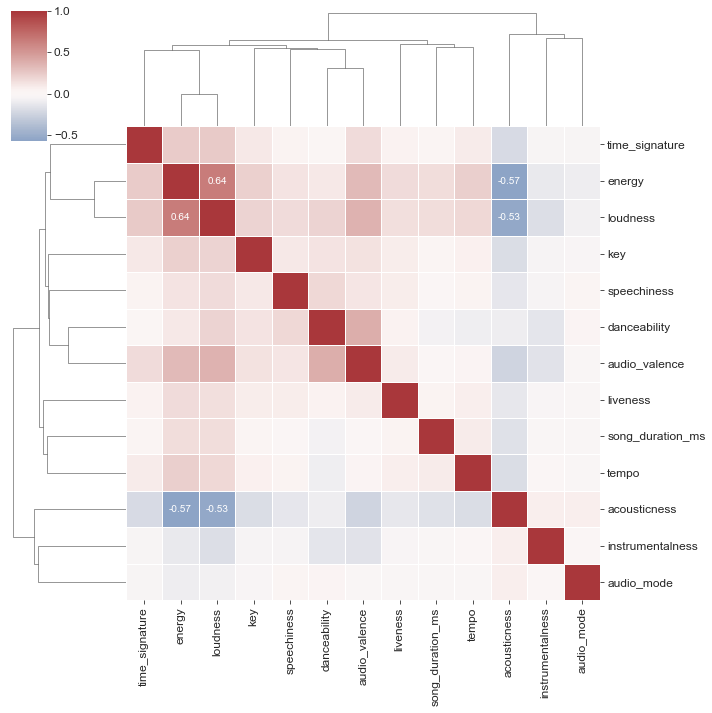

In [35]:
# fig, ax = plt.subplots(figsize=(20, 15))

labels = corr_matrix.applymap(lambda v: str(np.round(v, decimals=2)) if 1 > np.abs(v) >= .5 else '')
mask = np.zeros_like(corr_matrix)
mask[np.tril_indices_from(mask)] = True
sns.clustermap(corr_matrix, center=0, cmap='vlag', linewidth=1, annot=labels, fmt='')
# sns.heatmap(corr_matrix, cmap='RdBu', linewidth=1, annot=labels, mask=mask, square=True, fmt='')

We find:

* There's a strong anti-correlation between `acousticness` vs `energy` and `loudness`, respectively. Consequently, `energy` and `loudness` share a strong correlation.

* None of the features individually show a notable correlation with the target `song_popularity`.

### Categorical feature interactions

<AxesSubplot:xlabel='energy', ylabel='Density'>

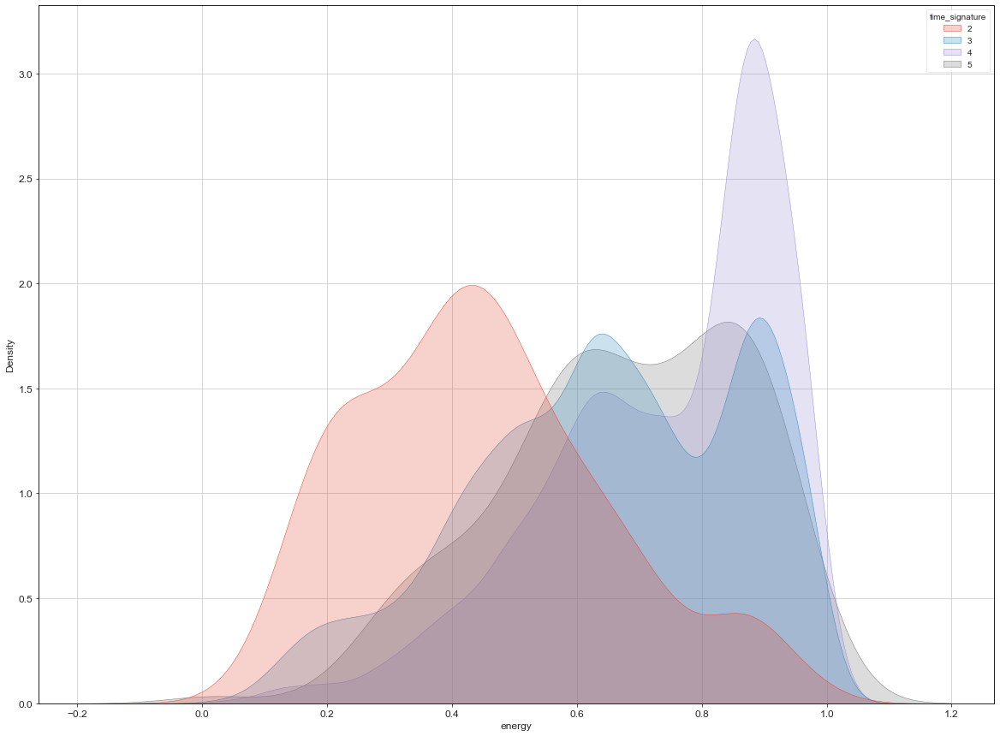

In [36]:
plt.figure(figsize=(20, 15))
sns.kdeplot('energy', hue='time_signature', data=train, fill=True, common_norm=False)

We find:

There are clear differences between the energy peaks for `time_signature = 2` vs `4`.

Smaller differences exist between the other values. `3` and `4` are the categories with the large numbers, and `4` is clearly more energetic than `3`.

<AxesSubplot:xlabel='key', ylabel='time_signature'>

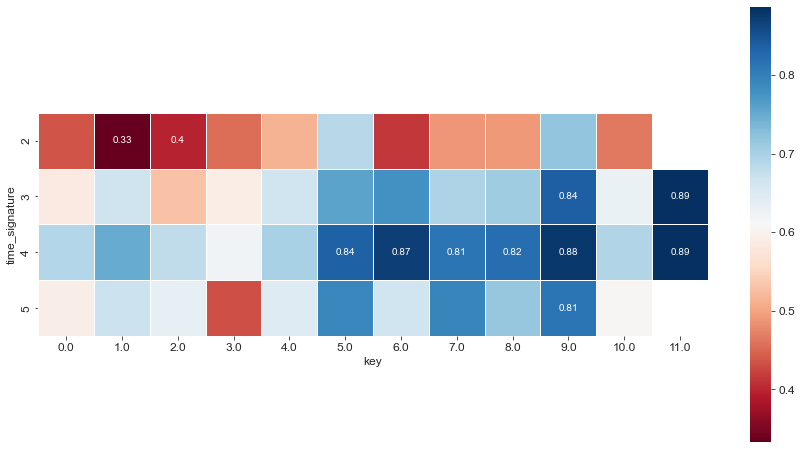

In [37]:
fig, ax = plt.subplots(figsize=(15, 8))

energy_O_key_at_time_signature = train.groupby(['key', 'time_signature']).median()['energy'].unstack().transpose()
labels = energy_O_key_at_time_signature.applymap(lambda v: str(np.round(v, decimals=2)) if np.abs(v) >= .8 or np.abs(v) <= .4 else '')
sns.heatmap(energy_O_key_at_time_signature, cmap='RdBu', linewidth=1, annot=labels, square=True, fmt='')

We find:

* For `time_signatures` `2` and `5` we have no instances of `key == 11`. This is no big surprise, since those three values are already rare individually, which makes their combinations even more rare.

* The lower keys and time signatures have less energy, on average, than the higher ones. In particular `key` 9 or 11.

### Contionus variables

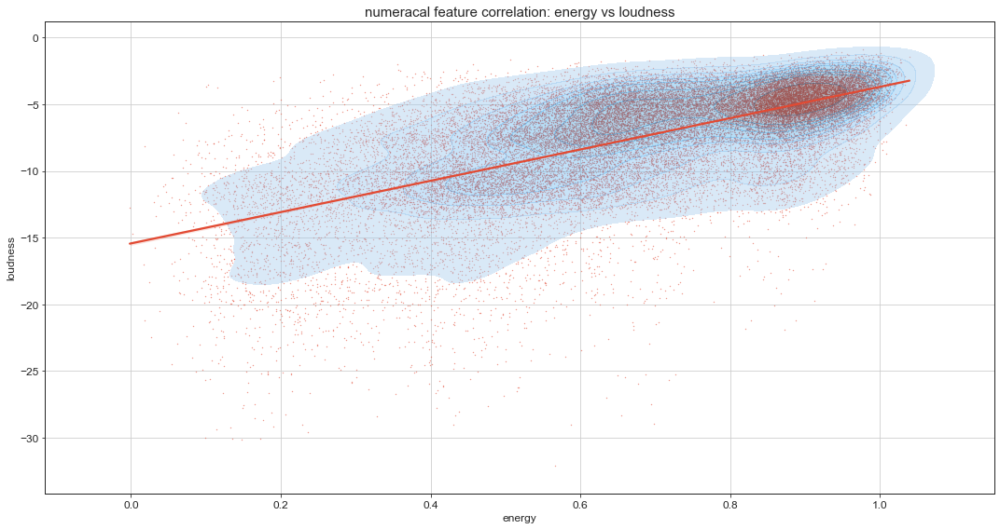

In [38]:
plt.figure(figsize=(15, 8))
ax = sns.regplot(x="energy", y="loudness", data=train, scatter=False)
plt.scatter(train["energy"], train["loudness"], s=1, alpha=.4, axes=ax)
sns.kdeplot(
    data=train, x="energy", y="loudness", fill=True, ax=ax, alpha=.4
)
ax.set_title('numeracal feature correlation: energy vs loudness', fontsize=15)
plt.tight_layout()
plt.show()

We find:

* The relationship looks pretty solid; not just built on outliers or strange.

* The 2 peaks of `energy` don't map 1:1 to the 2 peaks of `loudness` (which has a relatively similar distribution shape).

<Figure size 1080x576 with 0 Axes>

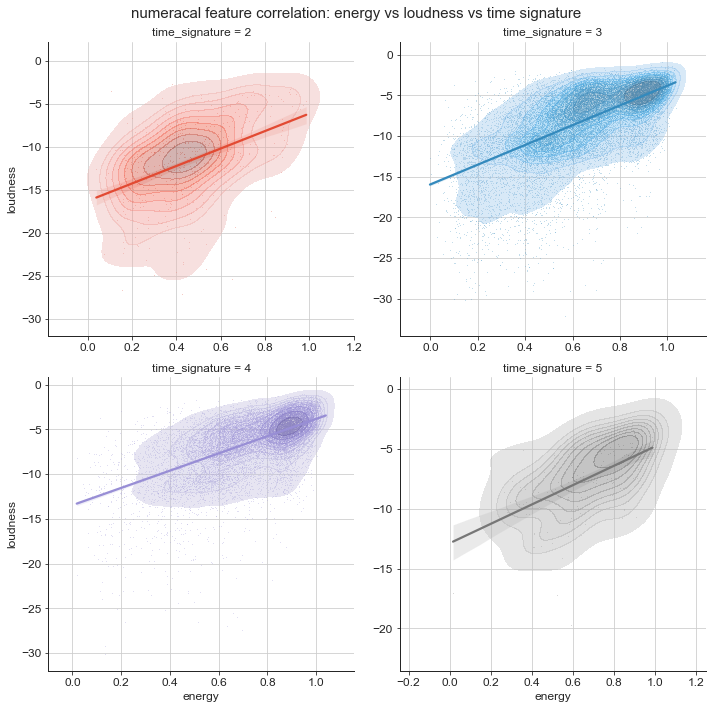

In [39]:
plt.figure(figsize=(15, 8))
ax = sns.FacetGrid(train, hue="time_signature", height=2.5, col_wrap=2, col="time_signature", sharex=False, sharey=False, size=5)
ax.map(sns.regplot, 'energy', 'loudness', scatter=False)
ax.map(sns.scatterplot, 'energy', 'loudness', alpha=.4, s=1)
ax.map(sns.kdeplot, 'energy', 'loudness', alpha=.4, fill=True)
ax.fig.suptitle('numeracal feature correlation: energy vs loudness vs time signature', fontsize=15)
plt.tight_layout()
plt.show()

We find:

* Other than the obvious sparsity of the samples with `key` 2 or 5, we see slightly different relations between the better populate 3 and 4 facets.

* The `key == 4` sample appears to have on average fewer values below -15

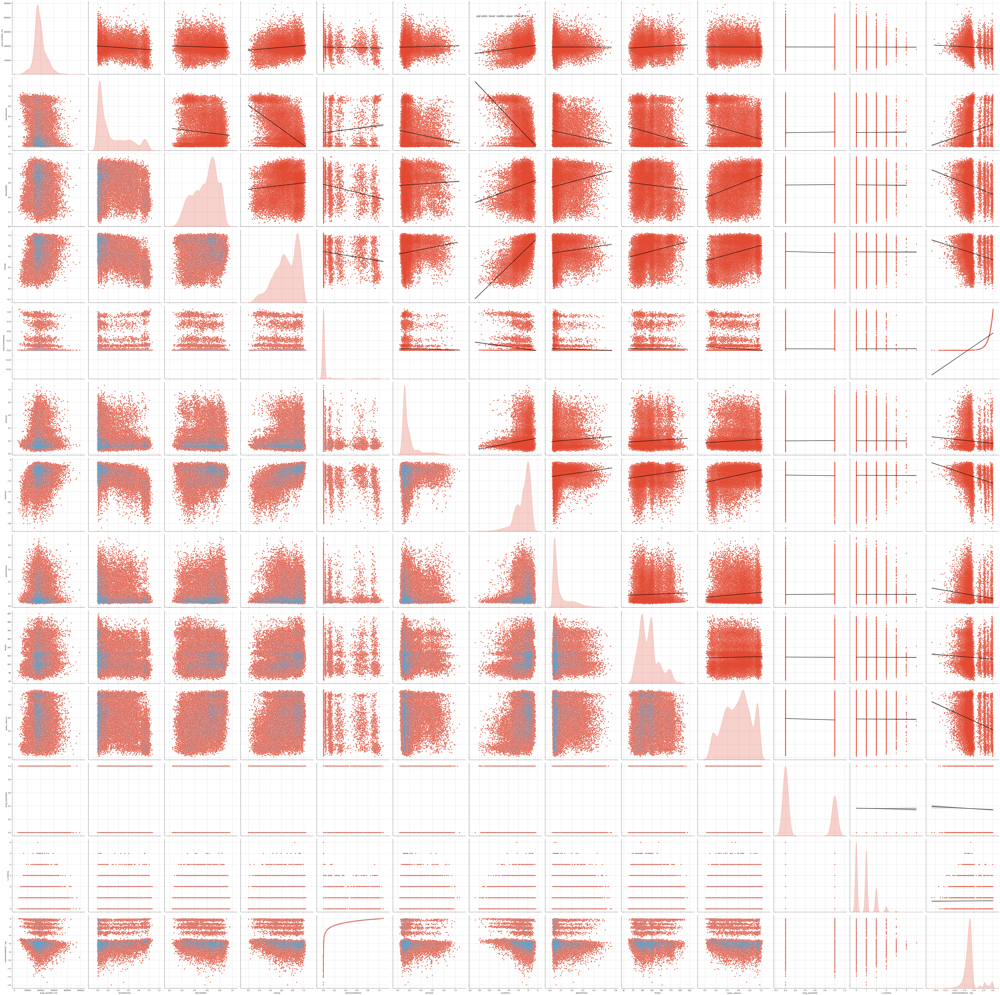

In [40]:
ax = sns.pairplot(train, diag_kind="kde", size=6)
ax.map_lower(sns.scatterplot, s=1, alpha=.4)
ax.map_upper(sns.regplot, line_kws={"color": "k"}, scatter_kws={"s": 1})
ax.fig.suptitle('pair plots: lower: scatter, upper: linear fit', fontsize=15)
plt.tight_layout()
plt.show()

We find:

* We've already seen the correlation strengths in the corrplot, and we know the distribution shapes from previous visuals.

* In the scatter facets, there's not much that calls for additional exploration. Most relations represent a pretty direct superposition of their 2 contributing feature distributions (and, for instance, their multi-peak structure).

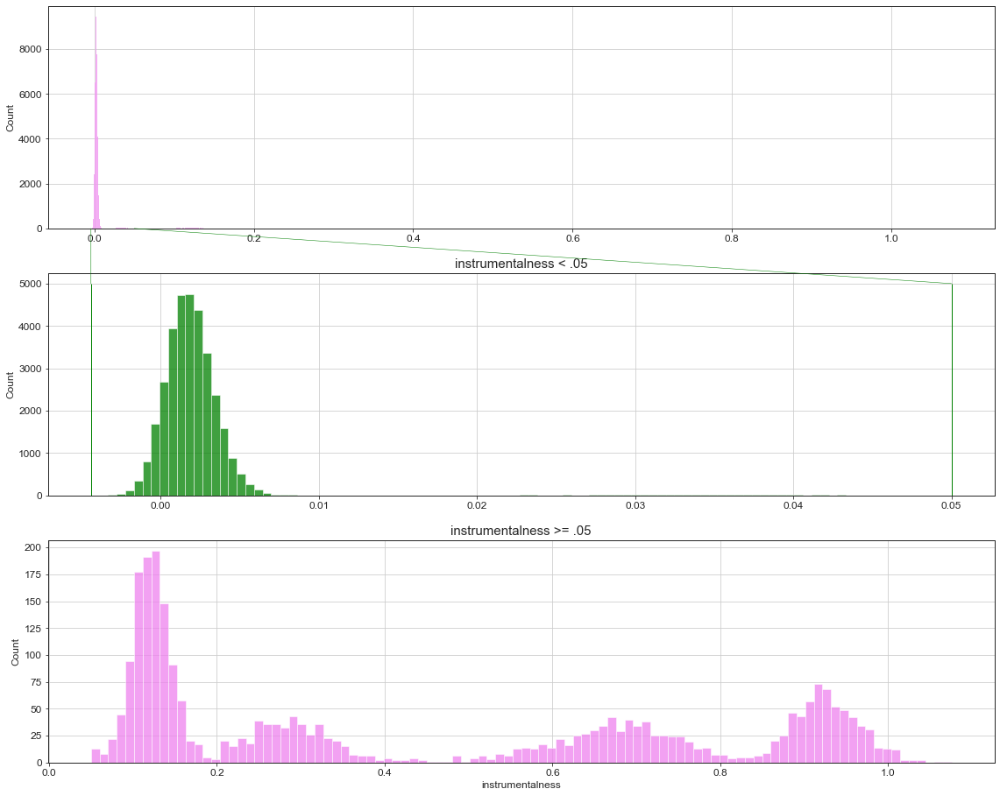

In [41]:
from matplotlib.patches import ConnectionPatch

# zoom in on instrumentalness
fig = plt.figure(figsize=(15, 12))
plt.subplots_adjust(bottom = 0., left = 0, top = 1., right = 1)
sub1 = fig.add_subplot(3,1,1)
sub1 = sns.histplot(train['instrumentalness'], kde=False, bins=1000, color='violet')
sub1.set_xlabel('')

sub2 = fig.add_subplot(3,1,2) # two rows, two columns, second cell
sub2 = sns.histplot(train['instrumentalness'][train['instrumentalness'] < .05], kde=False, bins=100, color='green')
sub2.set_title('instrumentalness < .05', fontsize=15)
sub2.set_xlabel('')
plt.vlines([np.min(train['instrumentalness']), .05], 0, 5000, color='green', linewidth=1, axes=sub2)

sub3 = fig.add_subplot(3,1,3) 
sub3 = sns.histplot(train['instrumentalness'][train['instrumentalness'] >= .05], kde=False, bins=100, color='violet')
sub3.set_title('instrumentalness >= .05', fontsize=15)
con1 = ConnectionPatch(xyA=(0.05, 0), coordsA=sub1.transData, 
                       xyB=(.05, 5000), coordsB=sub2.transData, color = 'green')
fig.add_artist(con1)
con2 = ConnectionPatch(xyA=(np.min(train['instrumentalness']), 0), coordsA=sub1.transData, 
                       xyB=(np.min(train['instrumentalness']), 5000), coordsB=sub2.transData, color = 'green')
fig.add_artist(con2)

We find:

* This is a useful result, because it points towards a relatively well behaved part of the distribution below 0.01.

* We know that there are other values above that threshold of 0.01, so let's count both groups:

In [42]:
inst = (train['instrumentalness'][~train['instrumentalness'].isnull()] < .01).value_counts()
inst = pd.DataFrame({'subset': ['main_subset', 'side_subset'], 'n': inst, 'percentage': inst/inst.sum()})
inst.reset_index(inplace=True)
inst

,index,subset,n,percentage
0,True,main_subset,32763,0.909704
1,False,side_subset,3252,0.090296


About 91% of `instrumentalness` has values below 0.01 and fall into the "main distribution". The remaining 9% are above that threshold and we will call that the "side distribution".

That's enough sample size (in the side distribution) to plot both parts of `instrumentalness` next to each other, but in separate facets so that the presence of one distribution doesn't make it harder to see the other one. We'll also add some target impact while we're at it:

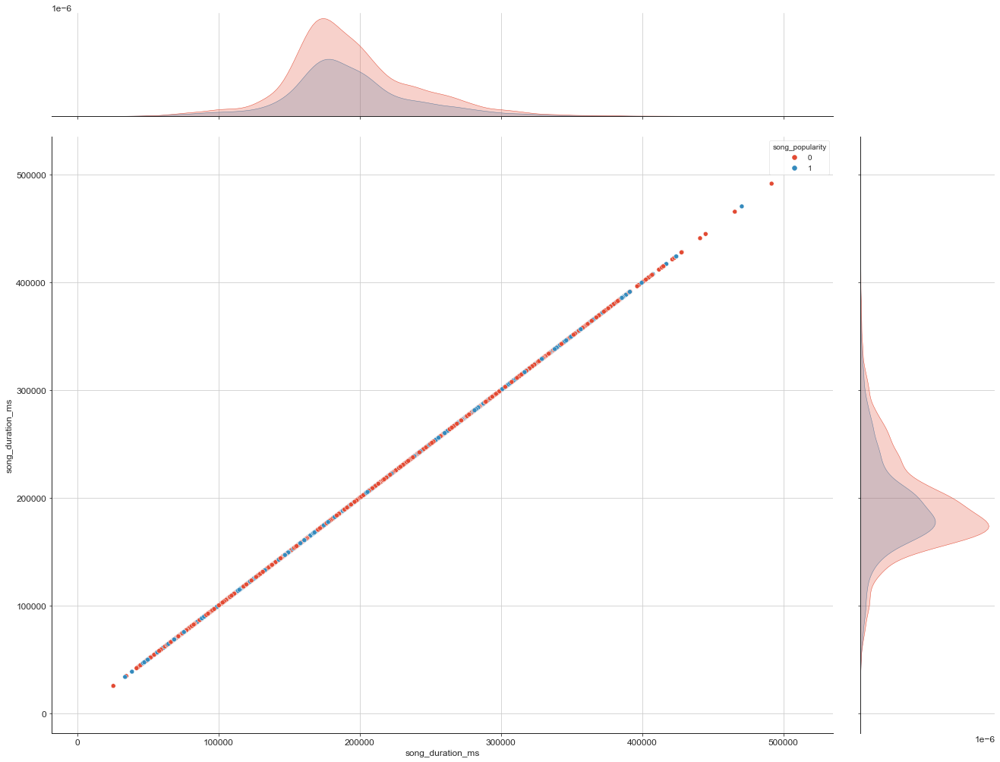

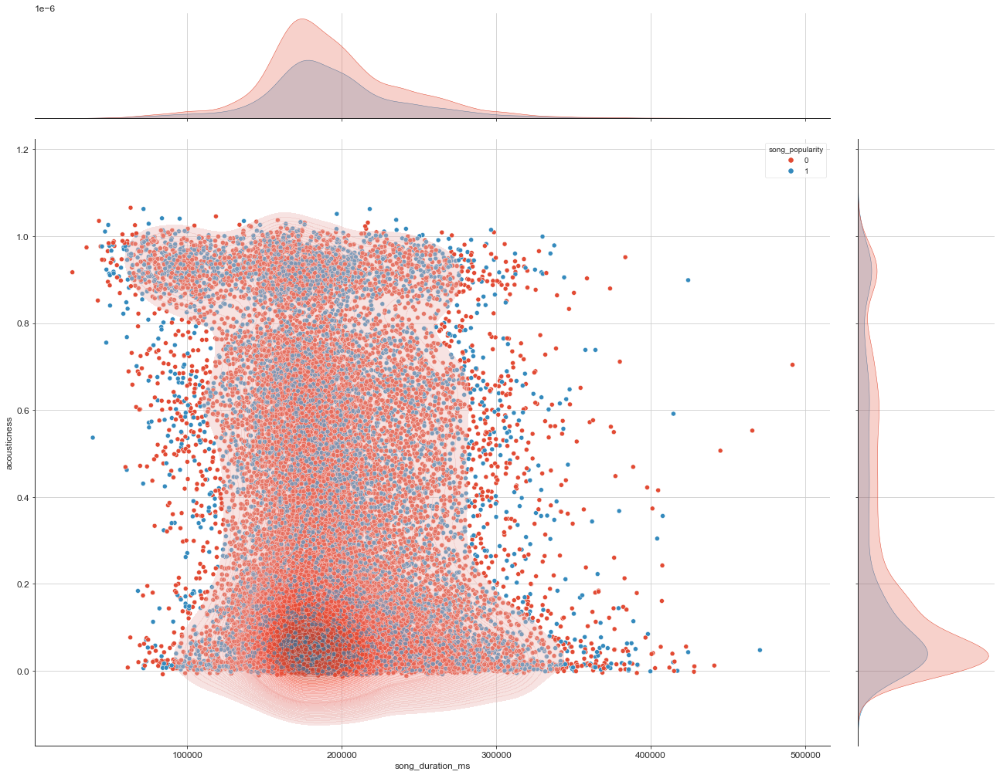

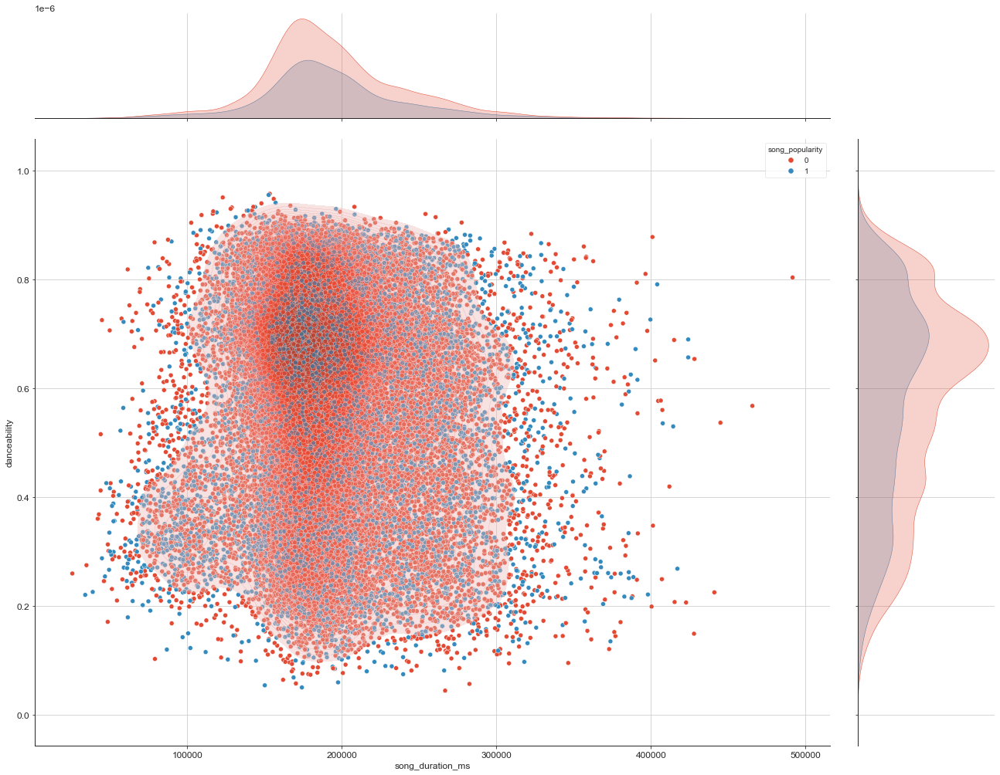

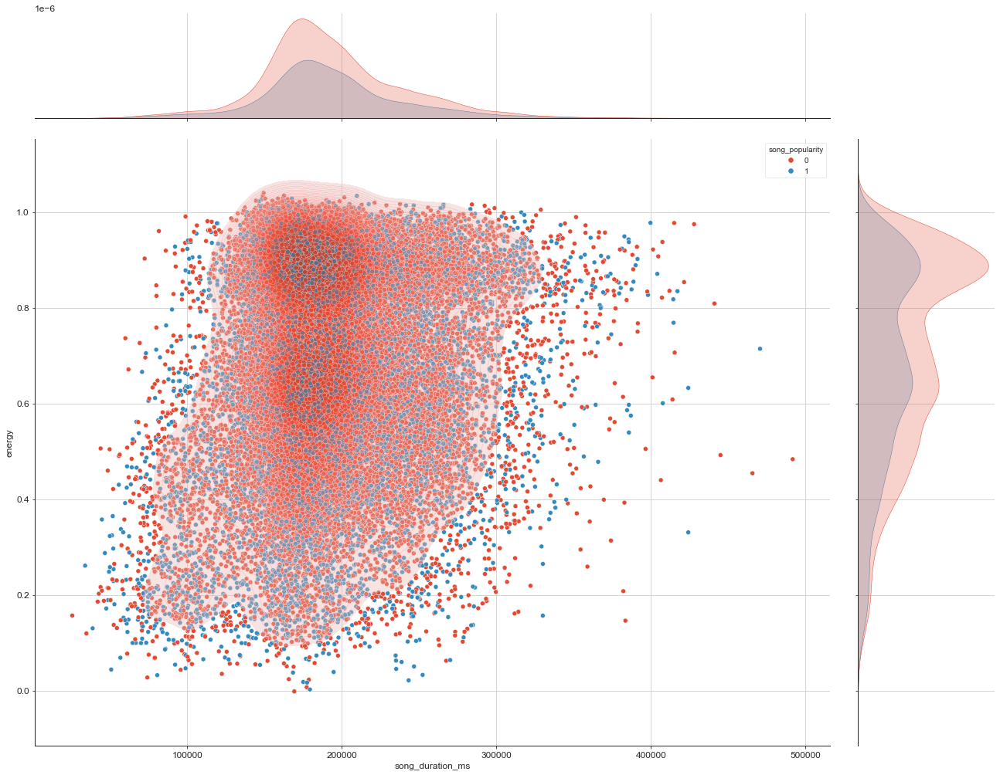

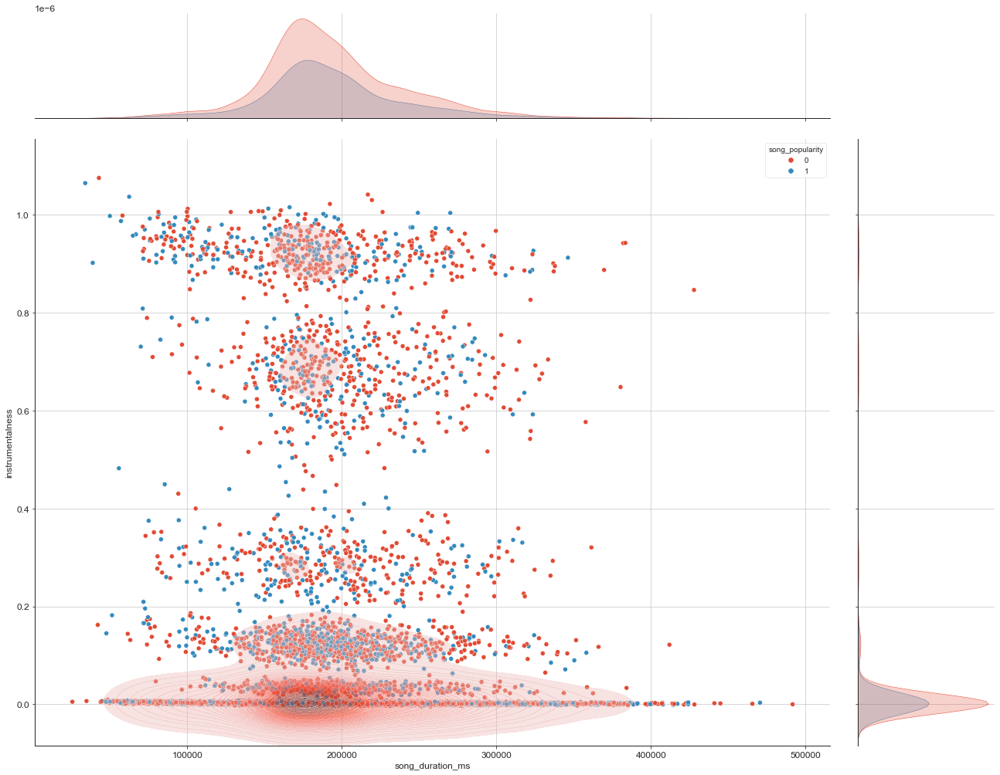

...

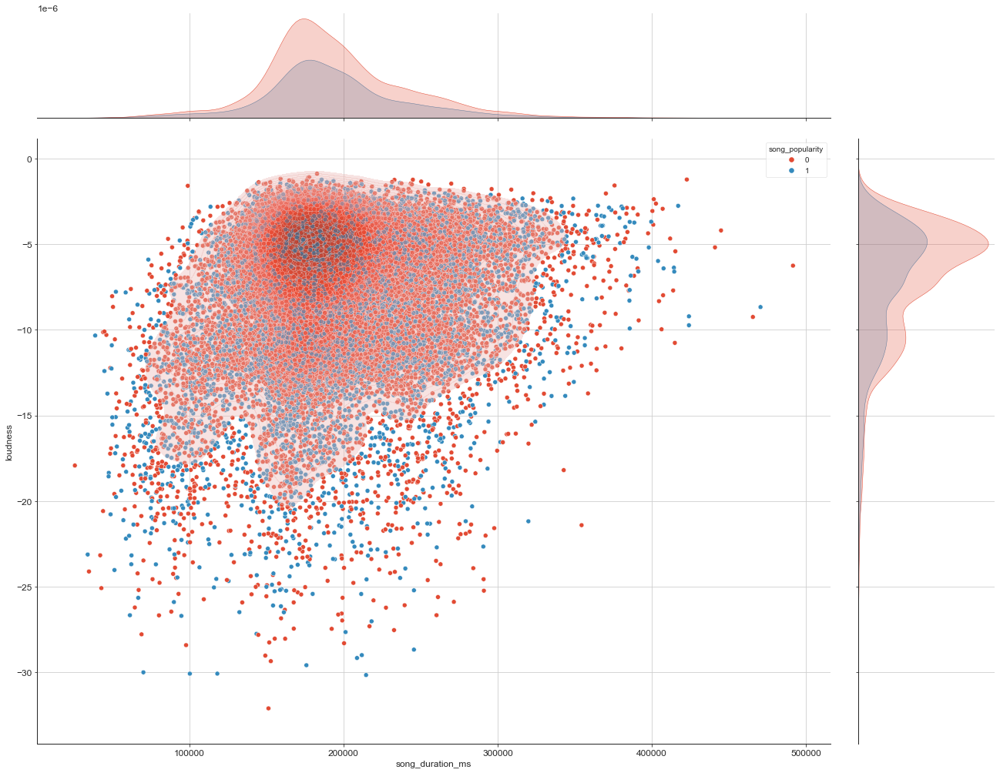

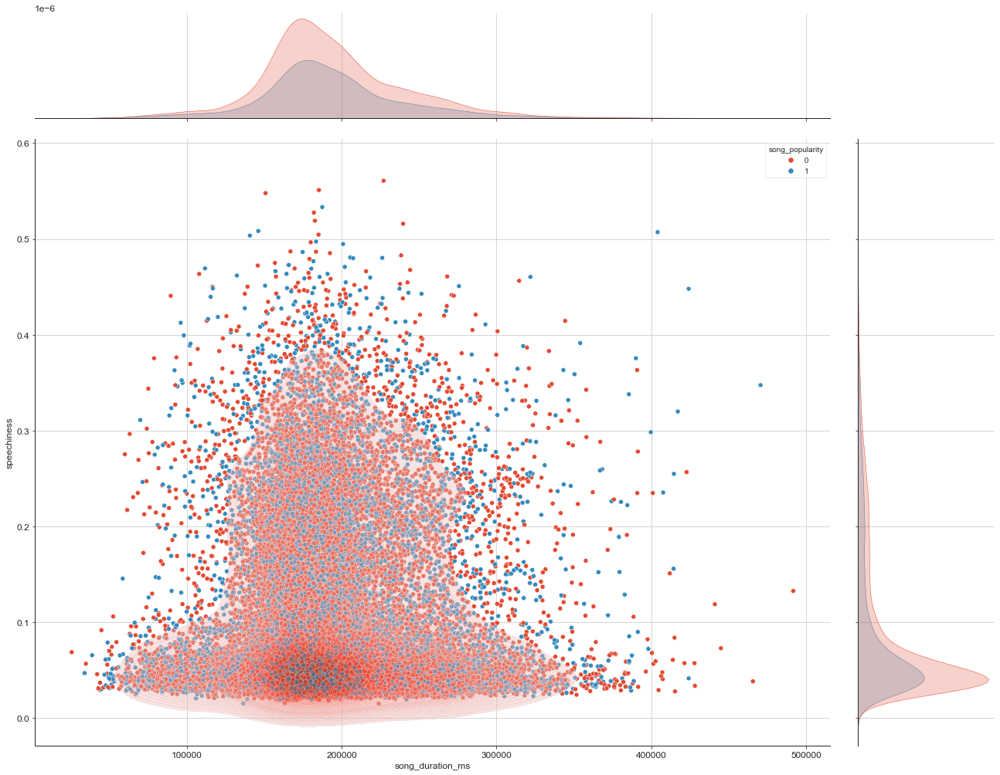

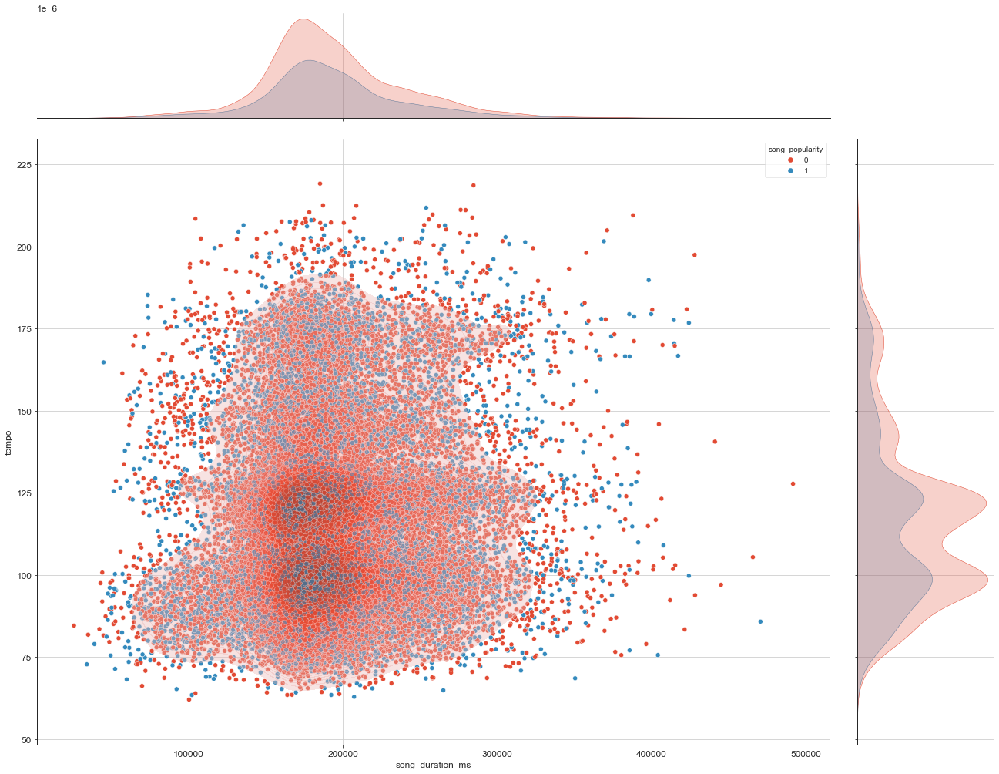

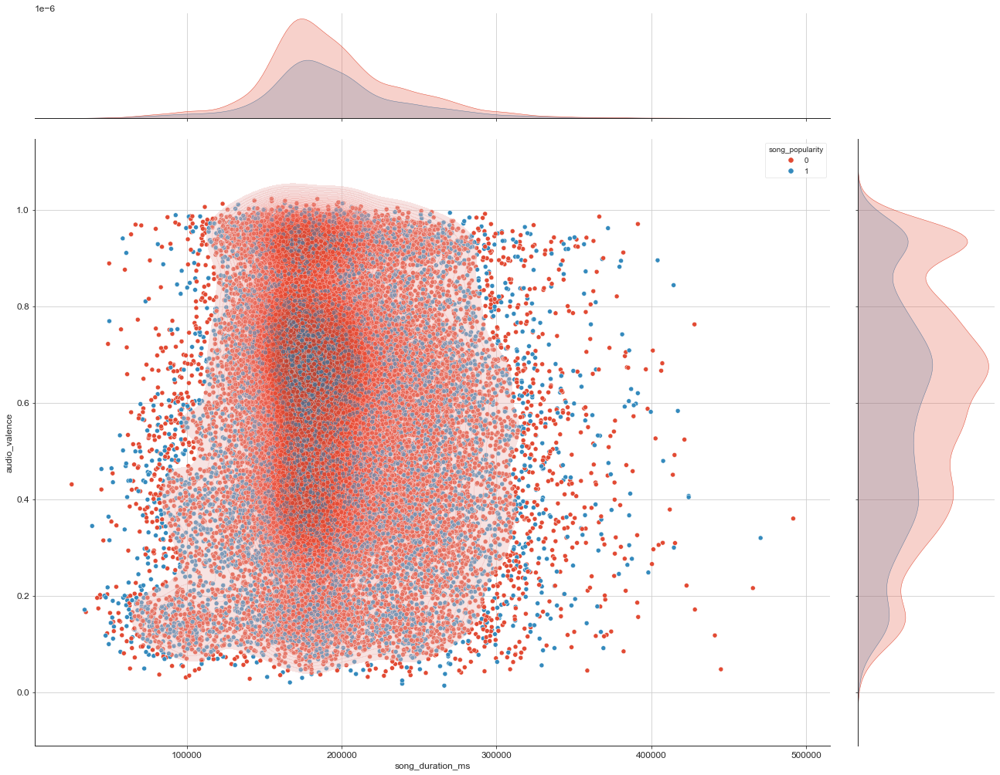

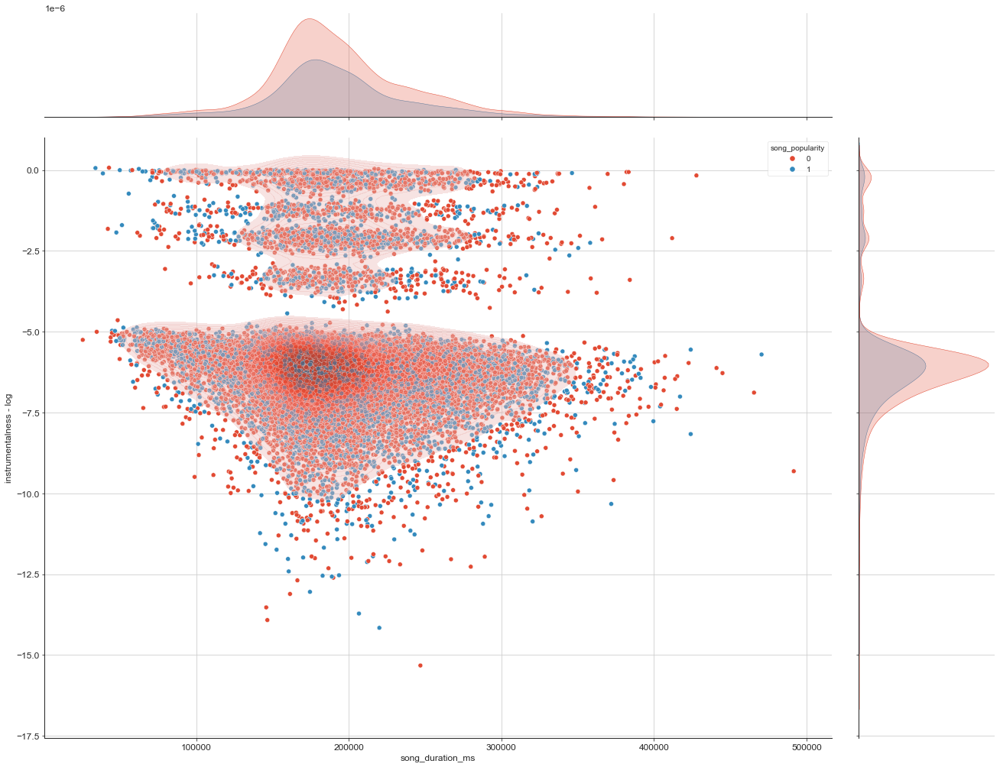

In [43]:
for i in cont_cols:
  ax = sns.jointplot(data=train, y=i, x='song_duration_ms', hue=col_y)
  if i != 'song_duration_ms':
    sns.kdeplot(data=train, y=i, x='song_duration_ms', n_levels=50, shade=True, alpha=.4, fill=True, ax=ax.ax_joint)
  plt.gcf().set_size_inches(20,15)


Maybe instrumentalness should be tansformed into discrete variables? Or categorical variable?

## On the hunt for outliers

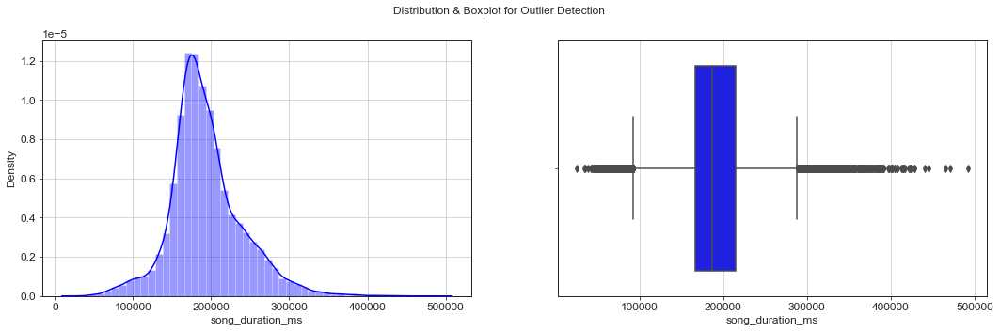

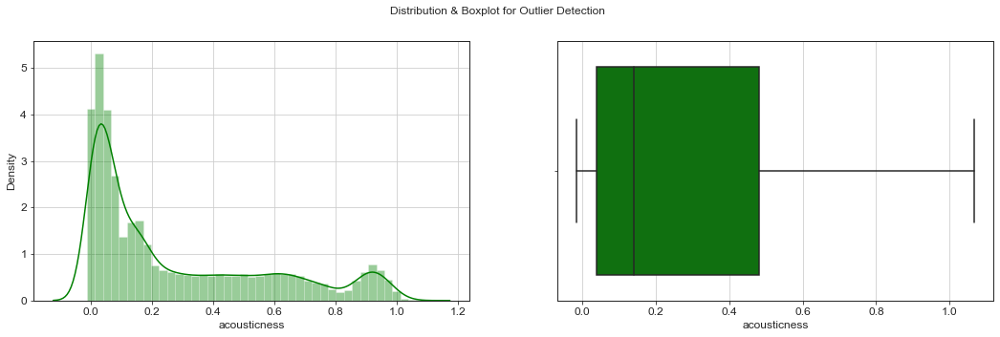

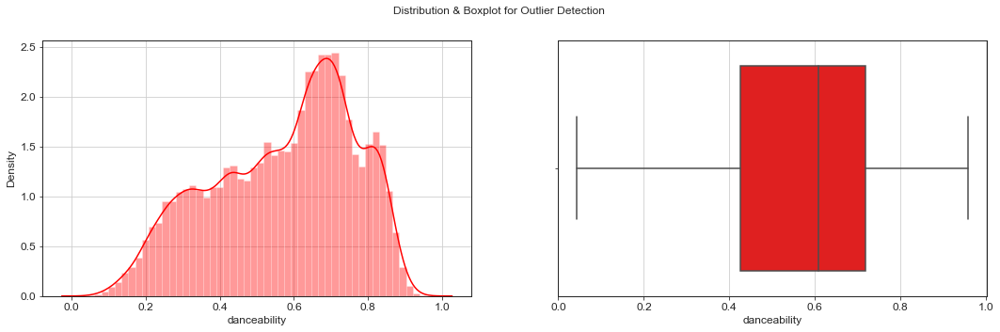

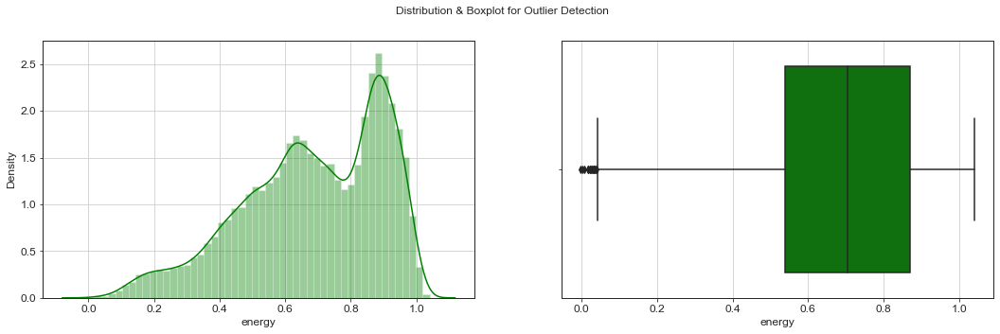

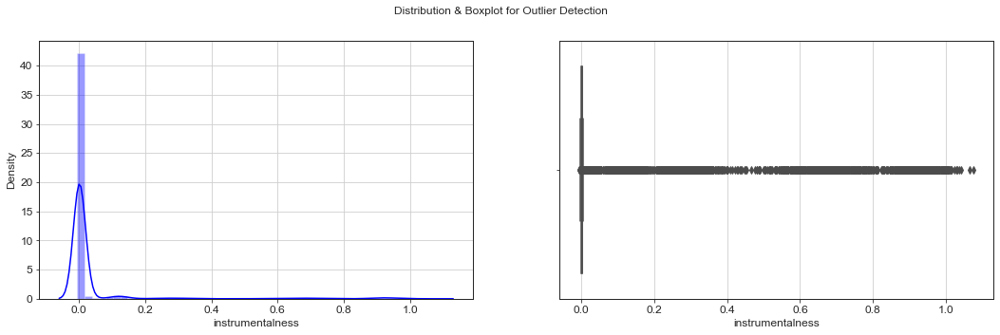

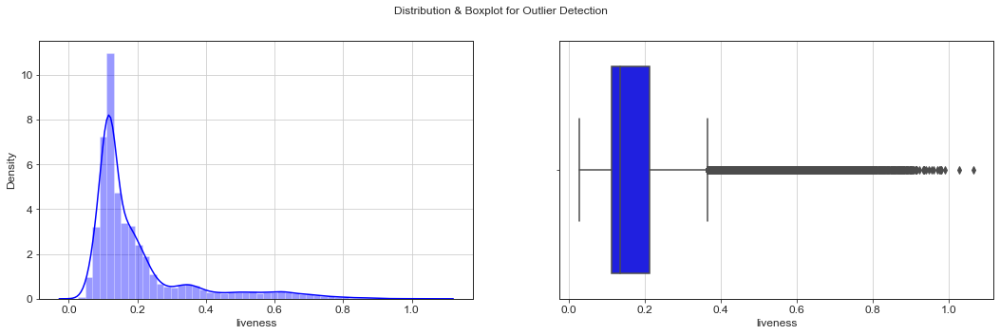

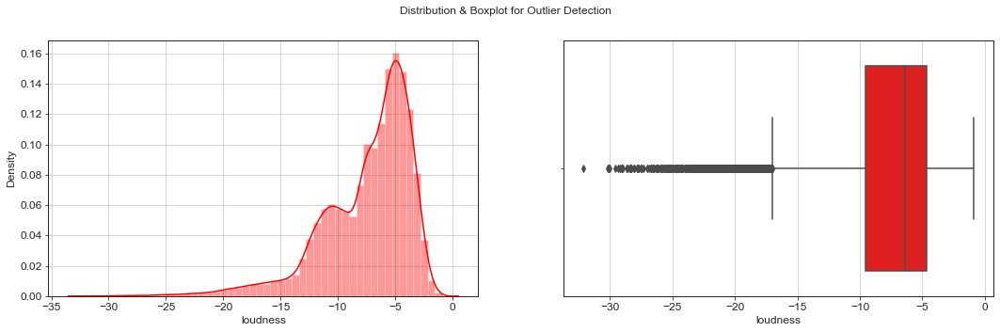

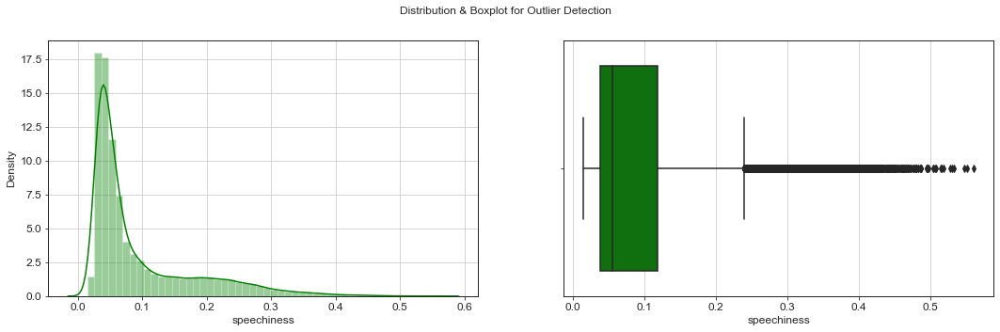

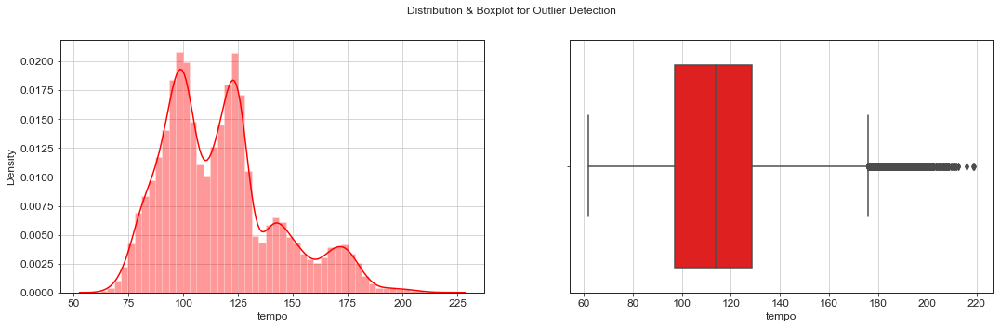

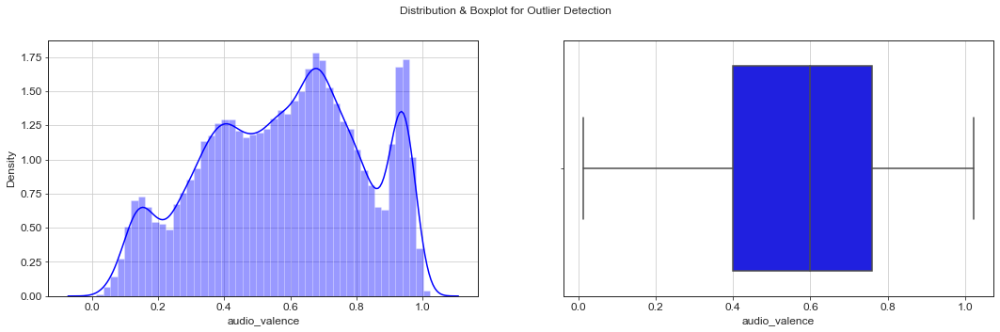

In [44]:
def outlier_viz(col):
    color = random.choice(['r', 'g', 'b'])
    fig, ax = plt.subplots(1,2,figsize=(18,5))
    sns.distplot(col, ax=ax[0], color=color)
    sns.boxplot(col, ax=ax[1], color=color)
    plt.suptitle('Distribution & Boxplot for Outlier Detection')
    fig.show()
    return None

num = ['song_duration_ms', 'acousticness', 'danceability', 'energy',
       'instrumentalness', 'liveness', 'loudness','speechiness', 'tempo', 'audio_valence']

for i in num:
    outlier_viz(train[i])

## Feature Engineering

### imputing na values

#### Simple Imputer

In [45]:
from sklearn.impute import SimpleImputer

simple_mean_imptr = SimpleImputer(strategy="mean", add_indicator=False)
tr_simple_imp = simple_mean_imptr.fit_transform(X_train[FEATURES])
tr_simple_imp = pd.DataFrame(tr_simple_imp, columns=FEATURES)

#### [Iterative Imputer!](https://scikit-learn.org/stable/modules/generated/sklearn.impute.IterativeImputer.html)

Multivariate imputer that estimates each feature from all the others.

A strategy for imputing missing values by modeling each feature with missing values as a function of other features in a round-robin fashion.

Uses by default the BayesianRidge model to impute

In [46]:
%%time
from sklearn.experimental import enable_iterative_imputer
from sklearn.impute import IterativeImputer

it_imputer = IterativeImputer(max_iter=10)
train_iterimp = it_imputer.fit_transform(X_train[FEATURES])
train_iterimp = pd.DataFrame(train_iterimp, columns=FEATURES)

Wall time: 4.26 s


#### [KNN Imputer](https://scikit-learn.org/stable/modules/generated/sklearn.impute.KNNImputer.html)

Imputation for completing missing values using k-Nearest Neighbors.

In [47]:
%%time
from sklearn.impute import KNNImputer

knn_imptr = KNNImputer(n_neighbors=5, weights="distance", add_indicator=True)
train_knnimp = knn_imptr.fit_transform(X_train[FEATURES])
mask = X_train.isna().any(axis=0)
imputed_col_names = ["_"+col+"_imputed_" for col in mask[mask].index]

train_knnimp = pd.DataFrame(train_knnimp, columns=FEATURES+imputed_col_names)
train_knnimp.head()

Wall time: 1min 33s


,song_duration_ms,acousticness,danceability,energy,instrumentalness,key,liveness,loudness,audio_mode,speechiness,...,time_signature,audio_valence,_song_duration_ms_imputed_,_acousticness_imputed_,_danceability_imputed_,_energy_imputed_,_instrumentalness_imputed_,_key_imputed_,_liveness_imputed_,_loudness_imputed_
0,249165.0,0.018023,0.691292,0.782159,0.002070,7.0,0.253386,-4.446018,0.0,0.133197,...,4.0,0.291141,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0
1,262839.0,0.029204,0.296050,0.747173,0.000863,0.0,0.146838,-10.175356,1.0,0.331771,...,4.0,0.476756,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,249180.0,0.231342,0.240227,0.981282,0.003295,6.0,0.111339,-7.609018,0.0,0.095754,...,3.0,0.226383,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0
3,150192.0,0.896027,0.290141,0.260367,0.004380,10.0,0.210436,-12.902434,0.0,0.039707,...,3.0,0.436087,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,169956.0,0.606447,0.784803,0.662214,0.000923,4.0,0.353536,-7.492491,0.0,0.043732,...,3.0,0.343077,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0


#### [Iterative Imputer!](https://scikit-learn.org/stable/modules/generated/sklearn.impute.IterativeImputer.html)

Multivariate imputer that estimates each feature from all the others.

A strategy for imputing missing values by modeling each feature with missing values as a function of other features in a round-robin fashion.

Uses by default the BayesianRidge model to impute

In [48]:
%%time
from sklearn.experimental import enable_iterative_imputer
from sklearn.impute import IterativeImputer

it_imputer = IterativeImputer(max_iter=10)
train_iterimp = it_imputer.fit_transform(X_train[FEATURES])
train_iterimp = pd.DataFrame(train_iterimp, columns=FEATURES)

Wall time: 3.35 s


#### Check The Imputation Distribution

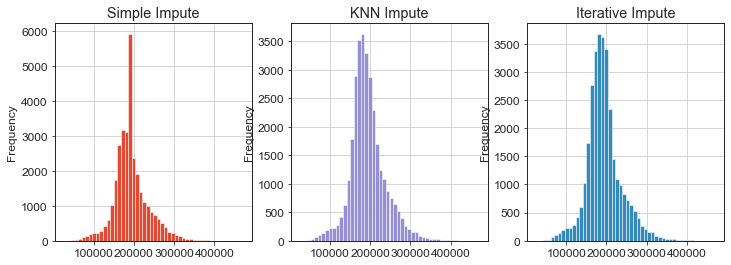

In [49]:
fig, axs = plt.subplots(1, 3, figsize=(12, 4))
axs = axs.flatten()
color_pal = plt.rcParams['axes.prop_cycle'].by_key()['color']

tr_simple_imp['song_duration_ms'] \
    .plot(kind='hist',
          bins=50,
          ax=axs[0],
          title='Simple Impute',
         color=color_pal[0])

train_iterimp['song_duration_ms'] \
    .plot(kind='hist',
          bins=50,
          ax=axs[2],
          title='Iterative Impute',
         color=color_pal[1])

train_knnimp['song_duration_ms'] \
    .plot(kind='hist',
          bins=50,
          ax=axs[1],
          title='KNN Impute',
         color=color_pal[2])
         
plt.show()

### handeling outliers

<!-- TODO:

https://machinelearningmastery.com/model-based-outlier-detection-and-removal-in-python/

https://pandas.pydata.org/docs/reference/api/pandas.DataFrame.apply.html

https://scikit-learn.org/stable/modules/generated/sklearn.preprocessing.FunctionTransformer.html

https://scikit-learn.org/stable/modules/generated/sklearn.ensemble.RandomTreesEmbedding.html#sklearn.ensemble.RandomTreesEmbedding

https://scikit-learn.org/stable/auto_examples/ensemble/plot_feature_transformation.html#sphx-glr-auto-examples-ensemble-plot-feature-transformation-py

https://scikit-learn.org/stable/auto_examples/compose/plot_column_transformer.html#sphx-glr-auto-examples-compose-plot-column-transformer-py

https://scikit-learn.org/stable/modules/generated/sklearn.compose.ColumnTransformer.html#sklearn.compose.ColumnTransformer

https://scikit-learn.org/stable/auto_examples/compose/plot_column_transformer_mixed_types.html#sphx-glr-auto-examples-compose-plot-column-transformer-mixed-types-py -->

In [114]:
# columns used for inverse sigmoid transformation
from sklearn.preprocessing import MinMaxScaler, minmax_scale, PowerTransformer, FunctionTransformer

col_sig = [
    'acousticness',
    'danceability',
    'energy',
    'instrumentalness',
    'liveness',
    'speechiness',
    'audio_valence',
]

col_pow = [
    'song_duration_ms',
    'tempo',
]

# make a custom transformer to transform the data
from sklearn.ensemble import IsolationForest
from sklearn.neighbors import LocalOutlierFactor
from sklearn.base import BaseEstimator, TransformerMixin

class PreProcessorTransformer(BaseEstimator, TransformerMixin):
    def __init__(self, cols, show_impute=False, inplace=False):
        self.show_impute = show_impute
        self.inplace = inplace
        self.col_sig, self.col_pow, self.loudness = cols
        self.cols = self.col_sig + self.col_pow
        self.inv_sigmoid = FunctionTransformer(lambda x: np.log(x / (1-x)))
        self.loudness_transformer = FunctionTransformer(lambda x: np.log1p(-x))
        
    def fit(self, X, y=None):
            
        self.scaler = MinMaxScaler(feature_range=(0+1e-6, 1-1e-6)).fit(X[self.col_sig])
        
        X_tmp = X[self.col_sig+self.col_pow].copy()
        X_tmp[self.col_sig] = self.scaler.transform(X_tmp[self.col_sig])
        X_tmp[self.col_sig] = self.inv_sigmoid.fit_transform(X_tmp[self.col_sig])
        
        self.transformer = PowerTransformer().fit(X_tmp)

        return self
    
    def transform(self, X):

        if not self.inplace:
            X = X.copy()
        
        X[self.col_sig] = self.scaler.transform(X[self.col_sig])
        X[self.col_sig] = self.inv_sigmoid.fit_transform(X[self.col_sig])
    #    # Box-Cox transformation
        X[self.col_sig+self.col_pow] = self.transformer.transform(X[self.col_sig+self.col_pow])
        X[self.loudness] = self.loudness_transformer.fit_transform(X[self.loudness])
        
        return X

class OutlierRemover(BaseEstimator, TransformerMixin):
    def __init__(self, **kwrgs):
        self.outlier_remover = LocalOutlierFactor(**kwrgs)
        pass

    def fit(self, X, y=None):
        return self

    def transform(self, X, y=None):
        y_hat = self.outlier_remover.fit_predict(X)
        mask = y_hat != -1
        y = y if not y is None else np.zeros(X.shape[0])
        return X.iloc[mask, :], y[mask]


transformer = PreProcessorTransformer([col_sig, col_pow, 'loudness'])
outlier_remover = OutlierRemover(n_neighbors=20, contamination=0.02)

In [120]:
from sklearn.pipeline import Pipeline
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import FunctionTransformer

# todo: https://www.analyticsvidhya.com/blog/2021/05/understanding-column-transformer-and-machine-learning-pipelines/
# outlier_remover = LocalOutlierFactor(n_neighbors=20, contamination=0.02, novelty=True)

pipe = Pipeline([
    ("transformation", transformer),
    ('outlier remover', outlier_remover),
])

pipe.fit(train_knnimp)
X_train_processed = pipe.transform(train_knnimp)[0]

In [121]:
X_train_processed.shape[0]/train_knnimp.shape[0]

0.98

Text(0.5, 1.0, 'after processing outliers')

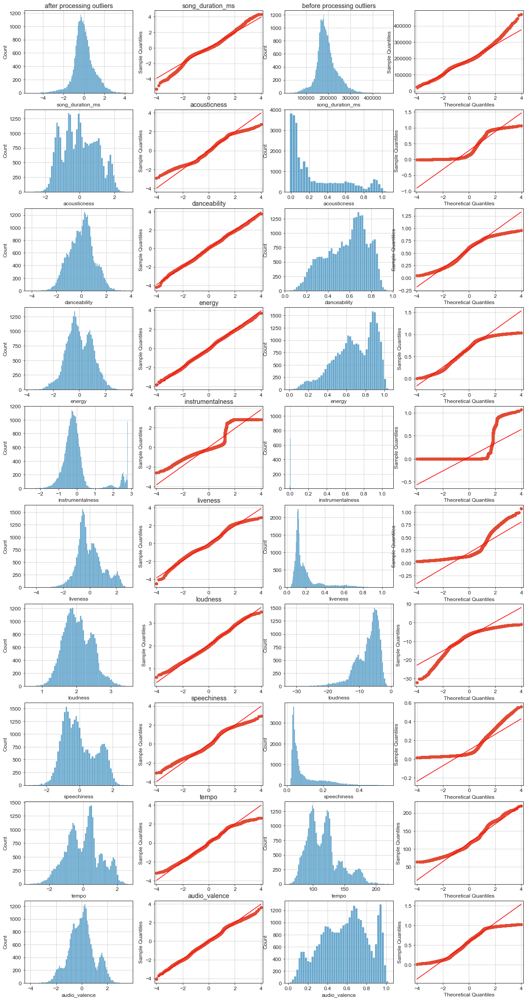

In [122]:
fig, axs = plt.subplots(len(numerical_cols), 4,
                        figsize=(10*2, len(numerical_cols)*4))

for i, col in enumerate(numerical_cols):
    sns.histplot(X_train_processed[col], ax=axs[i, 0])
    sm.qqplot(X_train_processed[col].dropna(), line="s", ax=axs[i, 1], fmt='r')
    sns.histplot(X_train[col], ax=axs[i, 2])
    sm.qqplot(X_train[col].dropna(), line="s", ax=axs[i, 3], fmt='r')
    axs[i, 1].set(xlabel='')
    axs[i, 1].set_title(col)

axs[0, 2].set_title('before processing outliers')
axs[0, 0].set_title('after processing outliers')

yep! looks normalized(gaussian distributed) now. Though `instrumentalness` still looks weird, all of the features share same range.

## EDA 2.0 - Unsupervised Learning

TODO:

https://scikit-learn.org/stable/auto_examples/compose/plot_compare_reduction.html#sphx-glr-auto-examples-compose-plot-compare-reduction-py

### Feature Engineering - Clustering

earlier we found that `instrumentalness` can be categorized into approximately 5-6 clusters

In [54]:
from sklearn.cluster import DBSCAN, KMeans, AgglomerativeClustering, Birch
from sklearn.preprocessing import StandardScaler, MinMaxScaler

#### kmeans

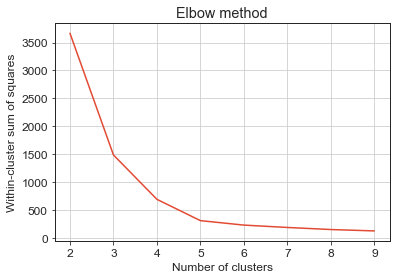

In [55]:
scaler = StandardScaler()
X_subset = train_knnimp[['instrumentalness']]
X_subset = scaler.fit_transform(X_subset)
wsss = []

for k in range(2, 10):
    kmeans = KMeans(n_clusters=k, random_state=0).fit(X_subset)
    wsss.append(kmeans.inertia_)

plt.plot(range(2, 10), wsss)
plt.xlabel('Number of clusters')
plt.ylabel('Within-cluster sum of squares')
plt.title('Elbow method')
plt.show()

optimal number of clusters might be 3, 4 or 5

In [56]:
scaler = StandardScaler()
X_subset = train_knnimp[['instrumentalness']]
X_subset = scaler.fit_transform(X_subset)

kmeans = KMeans(n_clusters=5, random_state=0).fit(X_subset)
labels = kmeans.labels_

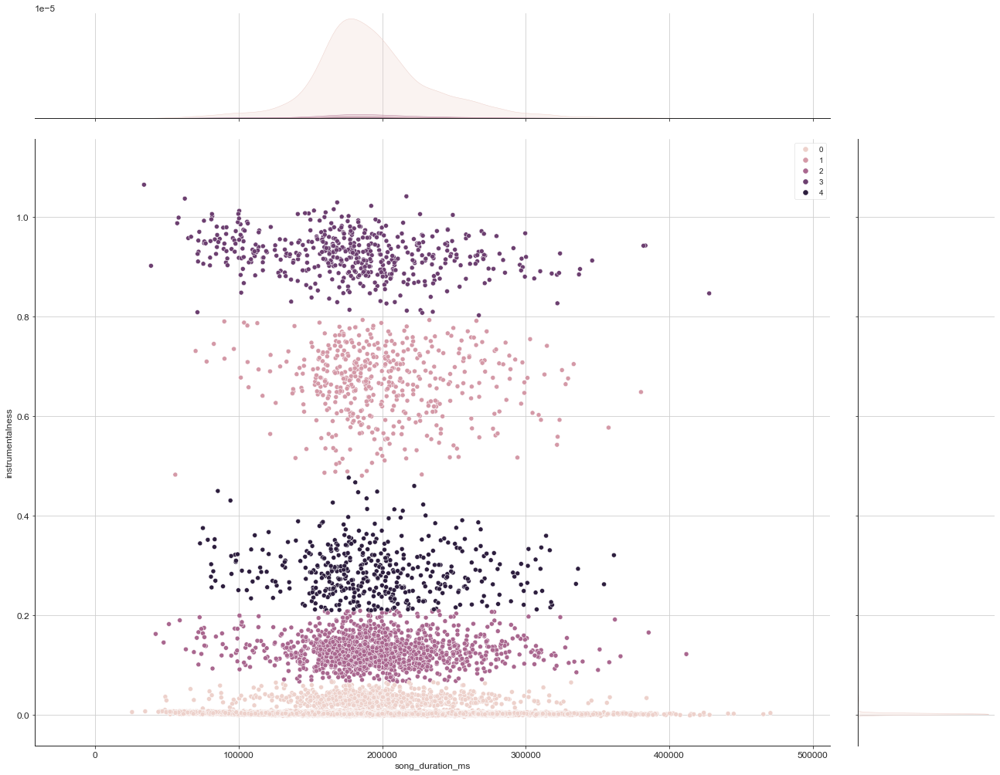

In [57]:
sns.jointplot(data=train_knnimp, y='instrumentalness', x='song_duration_ms', hue=labels)
plt.gcf().set_size_inches(20,15)

#### heirarchical clustering

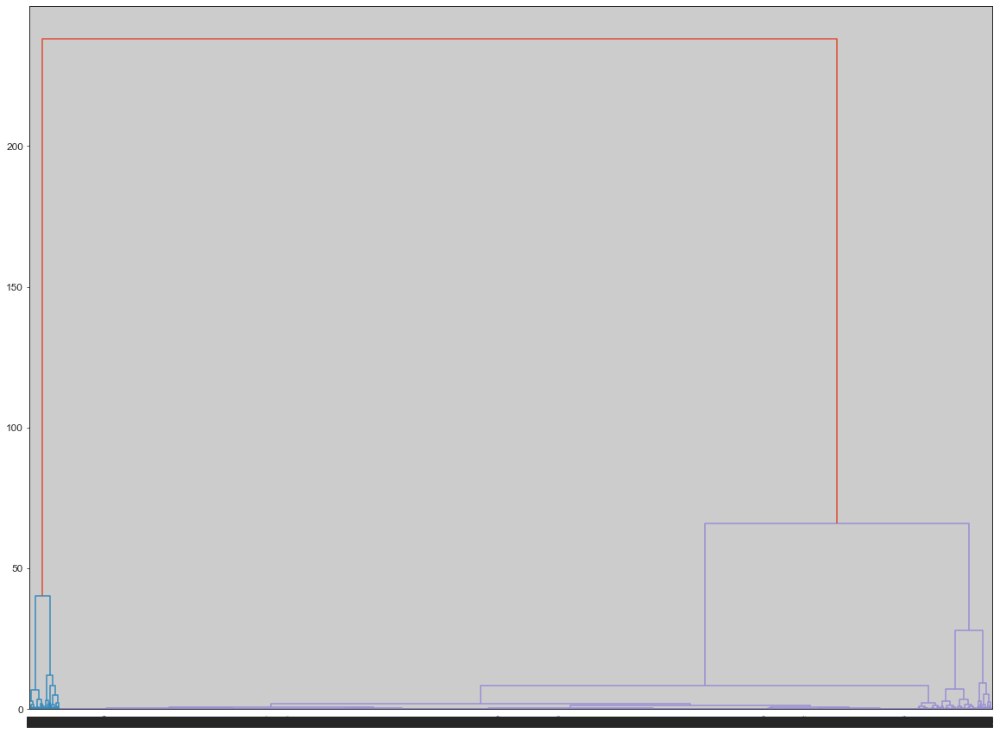

In [58]:
from scipy.cluster.hierarchy import dendrogram, linkage

# plot heirarchival cluster dendogram
Z = linkage(X_subset, 'ward')
dendrogram(Z, labels=train_knnimp.index, leaf_rotation=90)
plt.gcf().set_size_inches(20,15)

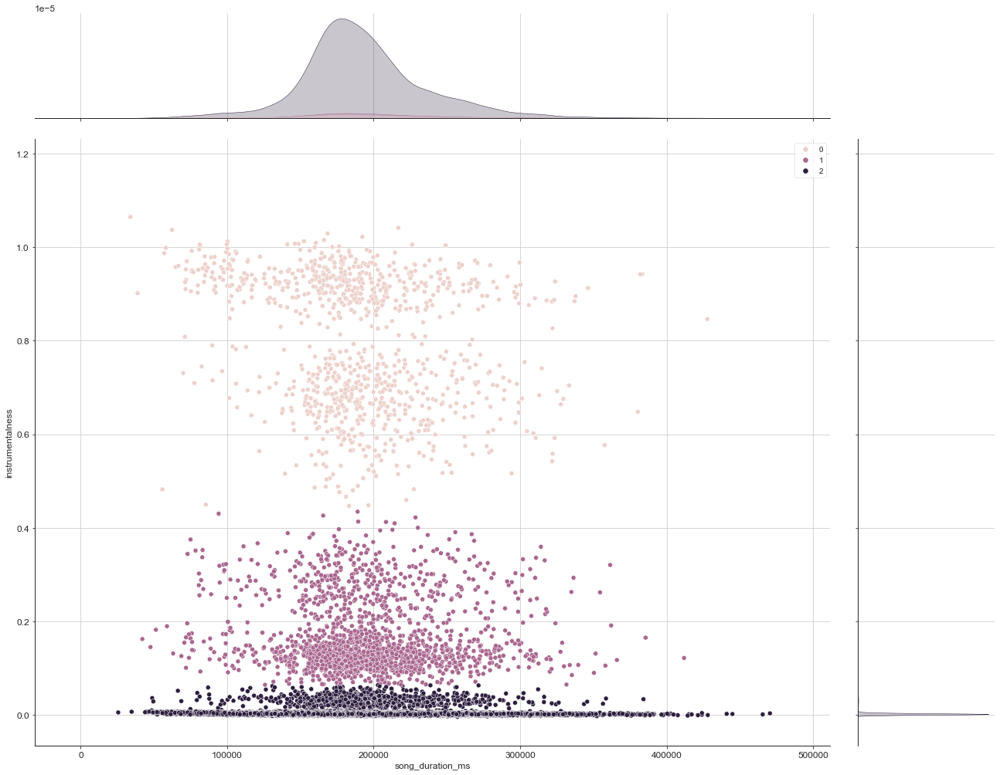

In [59]:
hc = AgglomerativeClustering(n_clusters=3, affinity='euclidean', linkage='ward')
labels = hc.fit_predict(X_subset)

sns.jointplot(data=train_knnimp, y='instrumentalness', x='song_duration_ms', hue=labels)
plt.gcf().set_size_inches(20,15)

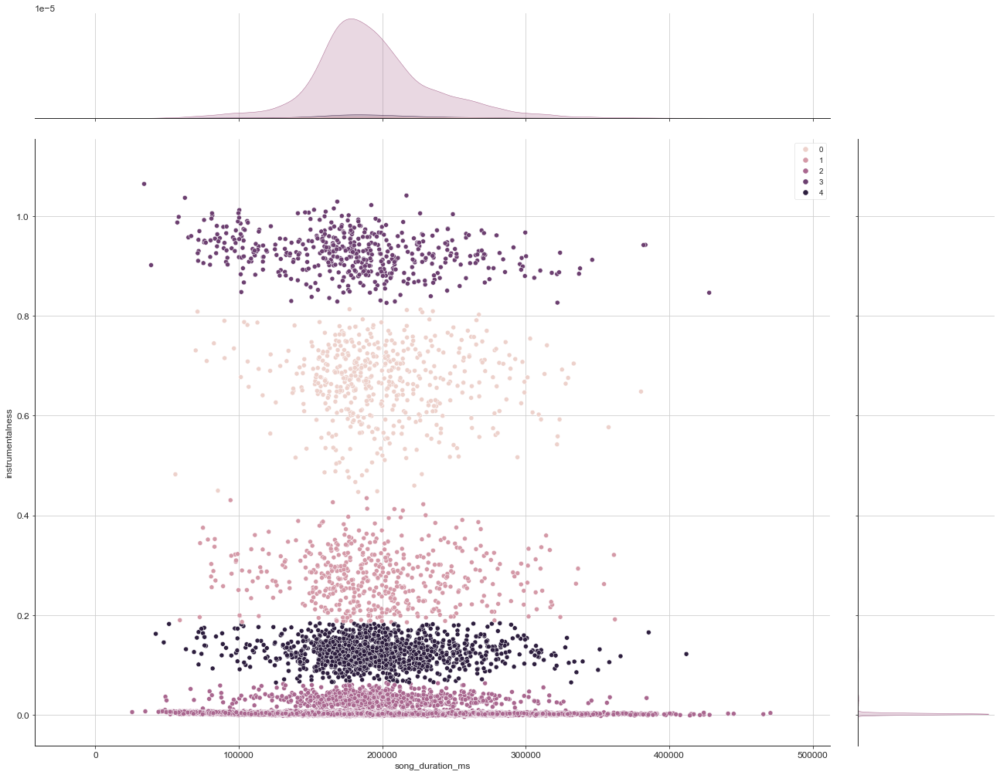

In [60]:
hc = AgglomerativeClustering(n_clusters=5, affinity='euclidean', linkage='ward')
labels = hc.fit_predict(X_subset)

sns.jointplot(data=train_knnimp, y='instrumentalness', x='song_duration_ms', hue=labels)
plt.gcf().set_size_inches(20,15)

because knn clustering methode is computationally fast as well as being able to predict on new data, we'll use knn in our modeling